<a href="https://colab.research.google.com/github/RutwikP/BME_548_MachineLearning_In_Imaging_Final_Project/blob/main/BME548_Final_Project_SP2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Analysis of Correction of Spherical Aberrations in Microscopic Images using Physical Layers**

# **Machine Learning in Imaging Spring 2023**

**- Anusha Krishnamoorthy,**
**Rutwik Palaskar** 


In [ ]:
# Data Loading
import zipfile
import os
import cv2
from tqdm import tqdm

# Data Processing and Visualization
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans
import skimage.io
from sklearn.model_selection import train_test_split

# Model
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Dropout 
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Conv2DTranspose
from tensorflow.keras.layers import concatenate
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, LearningRateScheduler
from tensorflow.keras import backend as keras
from tensorflow.keras import Model, Input
from keras import backend as K
from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras.metrics import MeanIoU

## Importing Data
- Details for loading kaggle dataset on to colab: https://www.kaggle.com/general/74235
- Dataset used: https://www.kaggle.com/competitions/data-science-bowl-2018/data

In [ ]:
from google.colab import files
files.upload()

# !rm -r ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
# Accept the challenge on kaggle to be able to download the dataset
!kaggle competitions download -c data-science-bowl-2018

100% 357M/358M [00:14<00:00, 29.7MB/s]
100% 358M/358M [00:14<00:00, 26.7MB/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# !find / -iname data-science-bowl-2018.zip

find: ‘/proc/61/task/61/net’: Invalid argument
find: ‘/proc/61/net’: Invalid argument
find: ‘/proc/2630/task/2630/net’: Invalid argument
find: ‘/proc/2630/net’: Invalid argument
/content/data-science-bowl-2018.zip


In [ ]:
!mkdir /content/Dataset/stage1_train
!mkdir /content/Dataset/stage1_test

# Unzipping dataset
!unzip -q /content/data-science-bowl-2018.zip -d /content/Dataset/
!unzip -q /content/Dataset/stage1_train.zip -d /content/Dataset/stage1_train/
!unzip -q /content/Dataset/stage1_test.zip -d /content/Dataset/stage1_test/

mkdir: cannot create directory ‘/content/Dataset/stage1_train’: No such file or directory
mkdir: cannot create directory ‘/content/Dataset/stage1_test’: No such file or directory


In [ ]:
main_path = '/content/data-science-bowl-2018.zip'
TRAIN_PATH = '/content/Dataset/stage1_train/'
TEST_PATH = '/content/Dataset/stage1_test/'

train_dir = os.listdir(TRAIN_PATH)
test_dir = os.listdir(TEST_PATH)

# Exploratory Data Analysis - Identifying Fluorescence Microscopy Images
- Adapted from: https://www.kaggle.com/code/mpware/stage1-eda-microscope-image-types-clustering

In [ ]:
STAGE1_TRAIN = TRAIN_PATH
STAGE1_TRAIN_IMAGE_PATTERN = "%s/{}/images/{}.png" % STAGE1_TRAIN
STAGE1_TRAIN_MASK_PATTERN = "%s/{}/masks/*.png" % STAGE1_TRAIN
IMAGE_ID = "image_id"
IMAGE_WIDTH = "width"
IMAGE_WEIGHT = "height"
HSV_CLUSTER = "hsv_cluster"
HSV_DOMINANT = "hsv_dominant"
TOTAL_MASK = "total_masks"
LABELS = 'labels'

In [ ]:
def image_ids_in(root_dir, ignore=[]):
    ids = []
    for id in os.listdir(root_dir):
        if id in ignore:
            print('Skipping ID:', id)
        else:
            ids.append(id)
    return ids

def read_image(image_id, space="rgb"):
    image_file = STAGE1_TRAIN_IMAGE_PATTERN.format(image_id, image_id)
    image = skimage.io.imread(image_file)
    # Drop alpha which is not used
    image = image[:, :, :3]
    if space == "hsv":
        image = skimage.color.rgb2hsv(image)
    return image

def read_image_labels(image_id, space="rgb"):
    image = read_image(image_id, space = space)
    mask_file = STAGE1_TRAIN_MASK_PATTERN.format(image_id)
    masks = skimage.io.imread_collection(mask_file).concatenate()    
    height, width, _ = image.shape
    num_masks = masks.shape[0]
    labels = np.zeros((height, width), np.uint16)
    for index in range(0, num_masks):
        labels[masks[index] > 0] = 255 #index + 1
    # print(labels)
    return image, labels, num_masks

# Load stage 1 image identifiers.
train_image_ids = tqdm(image_ids_in(STAGE1_TRAIN))

  0%|          | 0/670 [00:00<?, ?it/s]

In [ ]:
def get_domimant_colors(img, top_colors=2):
    img_l = img.reshape((img.shape[0] * img.shape[1], img.shape[2]))
    clt = KMeans(n_clusters = top_colors)
    clt.fit(img_l)
    # grab the number of different clusters and create a histogram
    # based on the number of pixels assigned to each cluster
    numLabels = np.arange(0, len(np.unique(clt.labels_)) + 1)
    (hist, _) = np.histogram(clt.labels_, bins = numLabels)
    # normalize the histogram, such that it sums to one
    hist = hist.astype("float")
    hist /= hist.sum()
    return clt.cluster_centers_, hist

def get_images_details(image_ids):
  details = []
  for image_id in image_ids:
      image_hsv, labels, num_masks = read_image_labels(image_id, space="hsv")
      height, width, l = image_hsv.shape
      dominant_colors_hsv, dominant_rates_hsv = get_domimant_colors(image_hsv, top_colors=1)
      dominant_colors_hsv = dominant_colors_hsv.reshape(1, dominant_colors_hsv.shape[0] * dominant_colors_hsv.shape[1])
      info = (image_id, labels, width, height, num_masks, dominant_colors_hsv.squeeze())
      details.append(info)
  return details

details = tqdm(get_images_details(train_image_ids))
# details = get_images_details(train_image_ids)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|          | 1/670 [00:01<14:02,  1.26s/it]/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|          | 2/670 [00:02<13:15,  1.19s/it]/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
  0%|          | 3/670 [00:03<13:34,  1.22s/it]/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set t

In [ ]:
META_COLS = [IMAGE_ID, LABELS, IMAGE_WIDTH, IMAGE_WEIGHT, TOTAL_MASK]
COLS = META_COLS + [HSV_DOMINANT]

trainPD = pd.DataFrame(details, columns=COLS)
X = (pd.DataFrame(trainPD[HSV_DOMINANT].values.tolist())).values
kmeans = KMeans(n_clusters=3).fit(X)
clusters = kmeans.predict(X)
trainPD[HSV_CLUSTER] = clusters
trainPD.head()

100%|██████████| 670/670 [00:00<00:00, 95753.84it/s]
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,image_id,labels,width,height,total_masks,hsv_dominant,hsv_cluster
0,2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,16,"[0.0, 0.0, 0.06277483771829058]",0
1,7f4d7b549d0f1a110191e2aded872943d85892bc30667f...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,10,"[0.0, 0.0, 0.0599682976217832]",0
2,4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",320,256,30,"[0.729256162450231, 0.27867600942105913, 0.805...",1
3,61dc249314d7b965eb4561ec739eab9b0f60af55c97b25...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",696,520,101,"[0.0, 0.0, 0.02938760163658708]",0
4,648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,86,"[0.0, 0.0, 0.13807301240808825]",0


In [ ]:
def plot_images(images, images_rows, images_cols):
    f, axarr = plt.subplots(images_rows,images_cols,figsize=(16,images_rows*2))
    for row in range(images_rows):
        for col in range(images_cols):
            image_id = images[row*images_cols + col]
            image = read_image(image_id)
            height, width, l = image.shape
            ax = axarr[row,col]
            ax.axis('off')
            ax.set_title("%dx%d"%(width, height))
            ax.imshow(image)

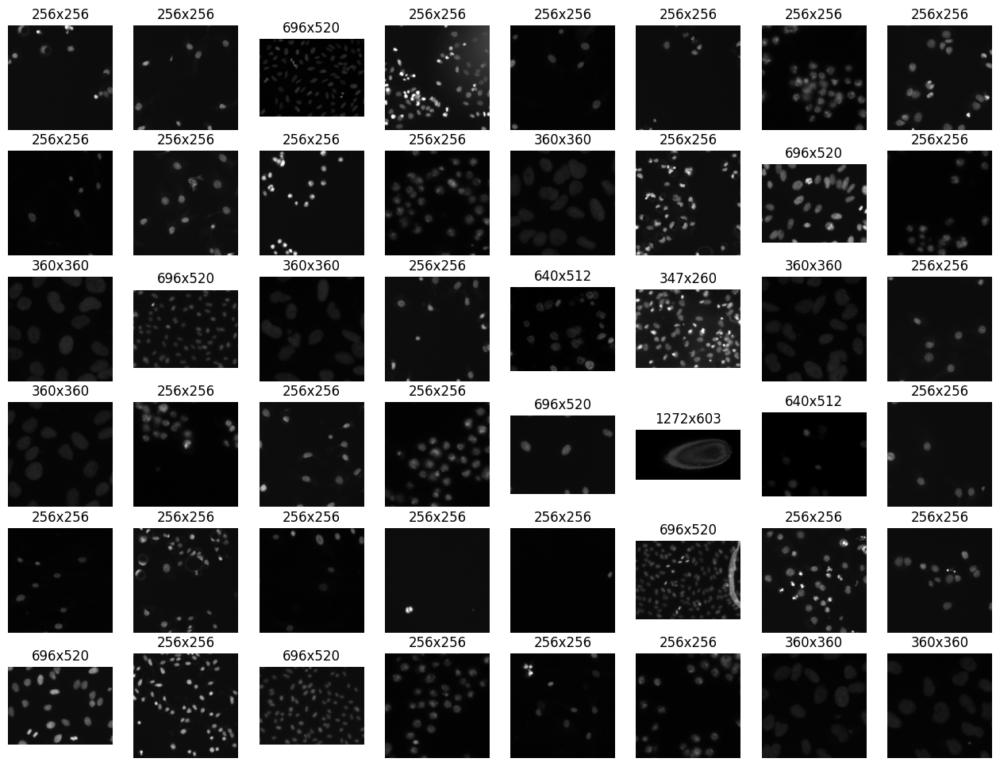

In [ ]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 0][IMAGE_ID].values, 6, 8)

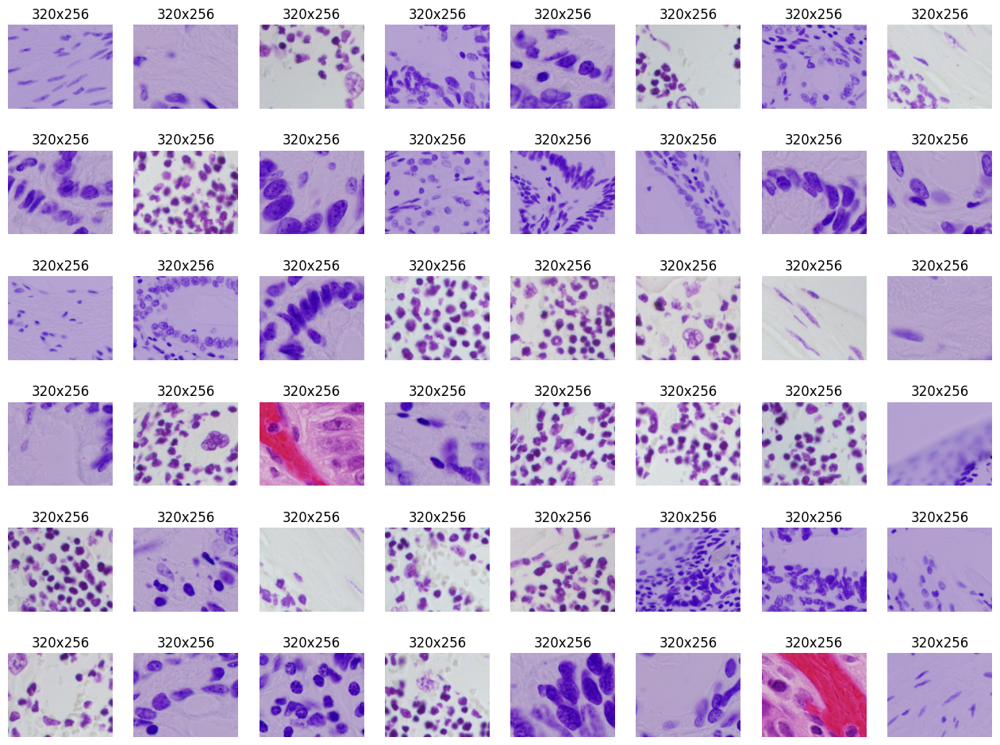

In [ ]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 1][IMAGE_ID].values, 6, 8)

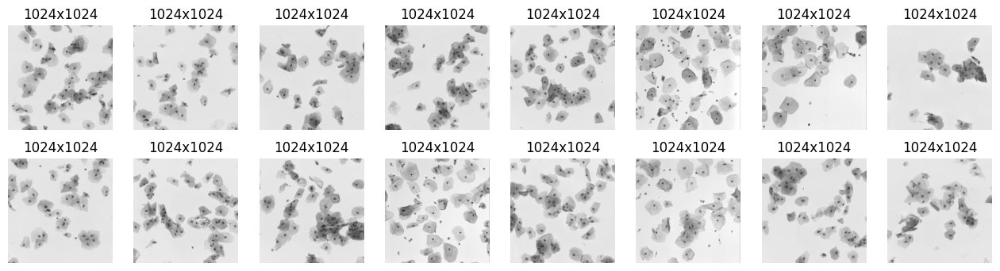

In [ ]:
plot_images(trainPD[trainPD[HSV_CLUSTER] == 2][IMAGE_ID].values, 2, 8)

In [ ]:
trainPD.head()

,image_id,labels,width,height,total_masks,hsv_dominant,hsv_cluster
0,2dd9d8c797fc695665326fc8fd0eb5cd292139fa478ccb...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,16,"[0.0, 0.0, 0.06277483771829058]",0
1,7f4d7b549d0f1a110191e2aded872943d85892bc30667f...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,10,"[0.0, 0.0, 0.0599682976217832]",0
2,4ae4f936a9ade472764dad80f60f7168e4be067aa66ce9...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",320,256,30,"[0.729256162450231, 0.27867600942105913, 0.805...",1
3,61dc249314d7b965eb4561ec739eab9b0f60af55c97b25...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",696,520,101,"[0.0, 0.0, 0.02938760163658708]",0
4,648636ee314d7bdba3ab2fc0fe49a863de35c3e2caf619...,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",256,256,86,"[0.0, 0.0, 0.13807301240808825]",0


# Basic Data Loading and Initial Preprocessing

In [ ]:
# Save fluroscent ids (locally) 
# trainPD.to_csv('/content/Dataset/clustered_img.csv')

# Filter rows where hsv_cluster is that of fluorescence microscopy
trainPD = pd.read_csv('/content/Dataset/clustered_img.csv')
trainPD

,Unnamed: 0,image_id,labels,width,height,total_masks,hsv_dominant,hsv_cluster
0,0,66236902b874b7e4b3891db63a69f6d56f6edcec6aca7b...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,360,360,25,[0. 0. 0.05853961],0
1,1,4ca5081854df7bbcaa4934fcf34318f82733a0f8c05b94...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,320,256,37,[0.7322206 0.27325564 0.80822749],1
2,2,9c95eae11da041189e84cda20bdfb75716a6594684de4b...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,256,256,20,[0. 0. 0.05810661],0
3,3,8cdbdda8b3a64c97409c0160bcfb06eb8e876cedc3691a...,[[255 255 255 ... 255 255 255]\n [255 255 255 ...,696,520,92,[0. 0. 0.07341795],0
4,4,2a2032c4ed78f3fc64de7e5efd0bec26a81680b07404ea...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,360,360,22,[0. 0. 0.04238374],0
...,...,...,...,...,...,...,...,...
665,665,353ab00e964f71aa720385223a9078b770b7e3efaf5be0...,[[ 0 0 0 ... 0 0 0]\n [ 0 0 0 ...,320,256,50,[0.62585549 0.18175115 0.79640773],1
666,666,3441821ebea04face181c9e2f4d0d09727c764827ac51b...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,360,360,28,[0. 0. 0.05216645],0
667,667,f6b16c885c0b2bc0d0eb2bb2eeb0a2753ebafb5a7a91da...,[[0 0 0 ... 0 0 0]\n [0 0 0 ... 0 0 0]\n [0 0 ...,256,256,8,[0. 0. 0.01695006],0
668,668,b0e35e06b85da49bfe3ea737711a72b551a6add446e30e...,[[255 255 255 ... 0 0 0]\n [255 255 255 ...,320,256,15,[0.74056554 0.29224971 0.78303663],1


Image Dimensions:  (670, 256, 256, 3) 
 Mask Dimensions:  (670, 256, 256)


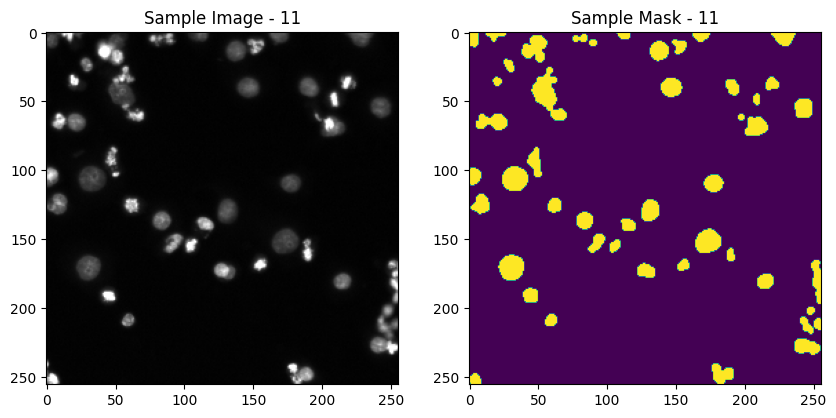

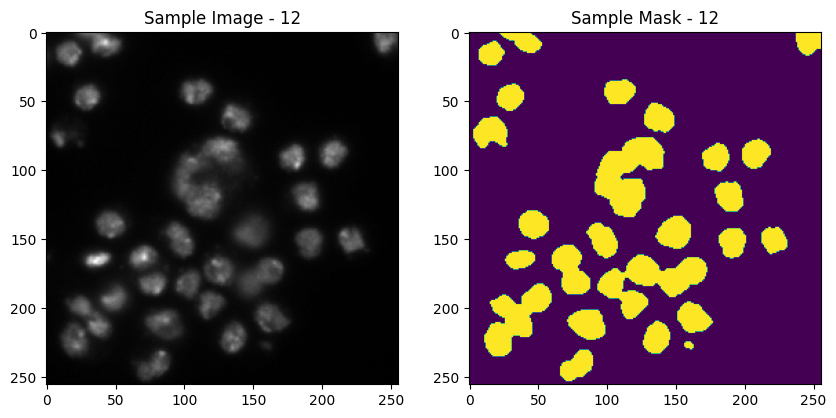

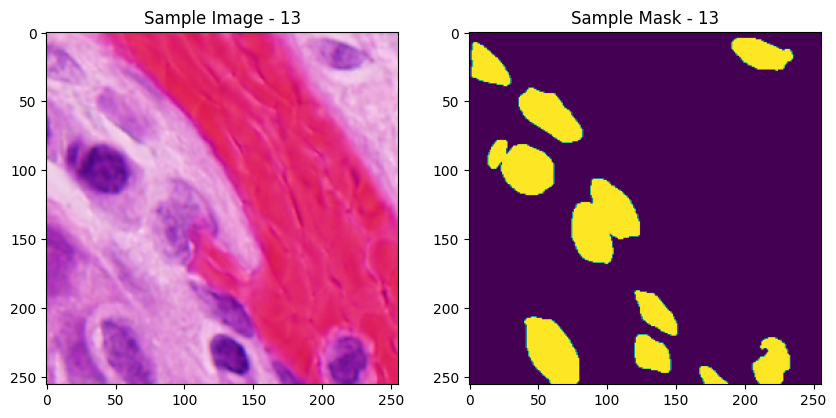

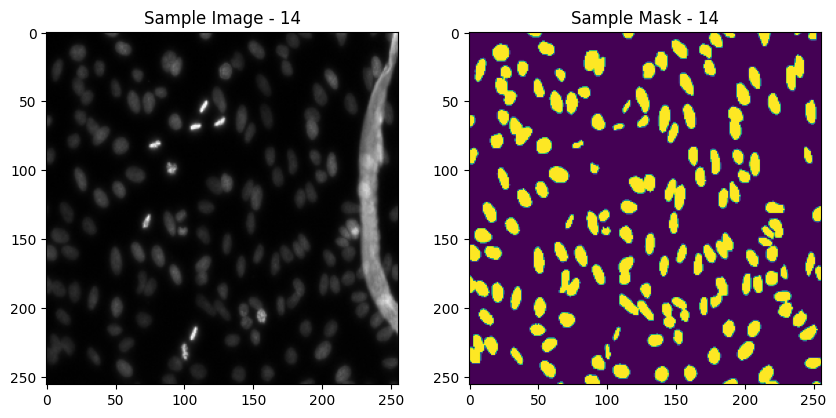

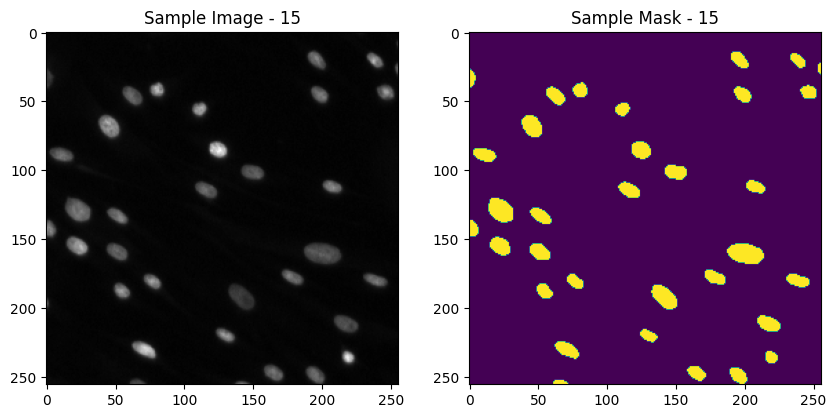

...

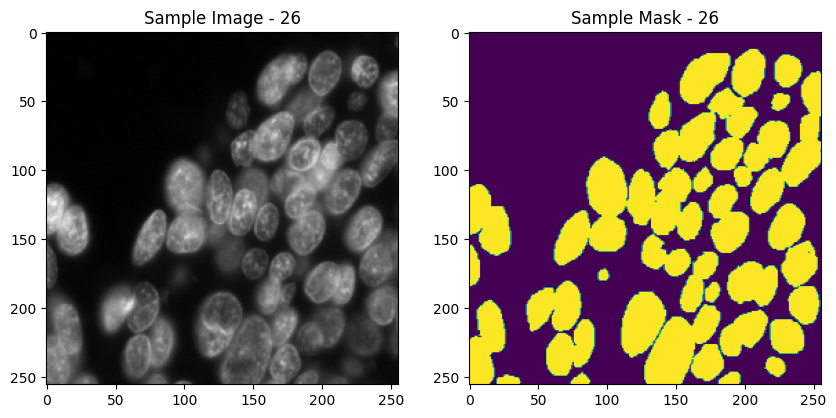

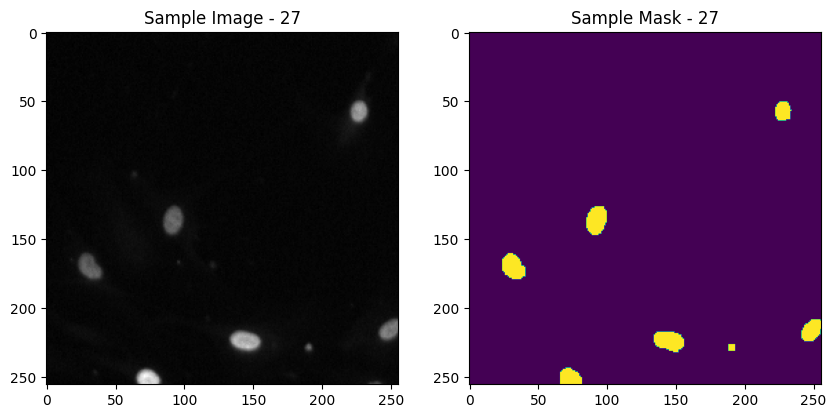

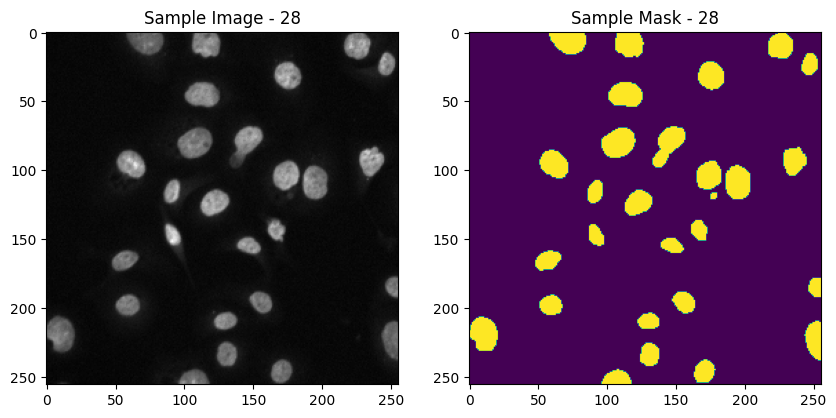

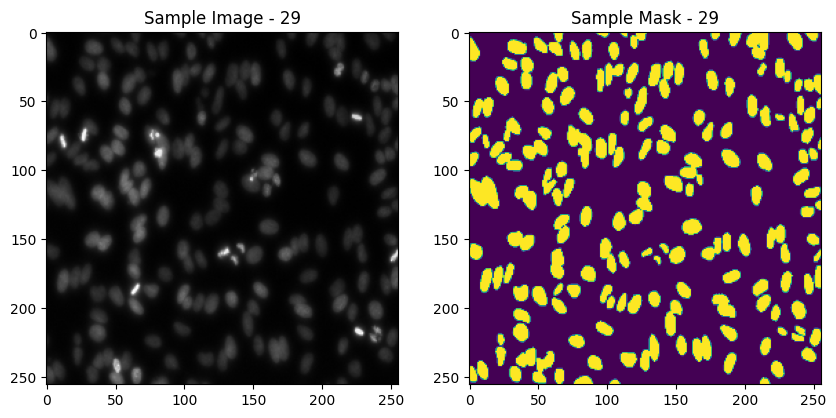

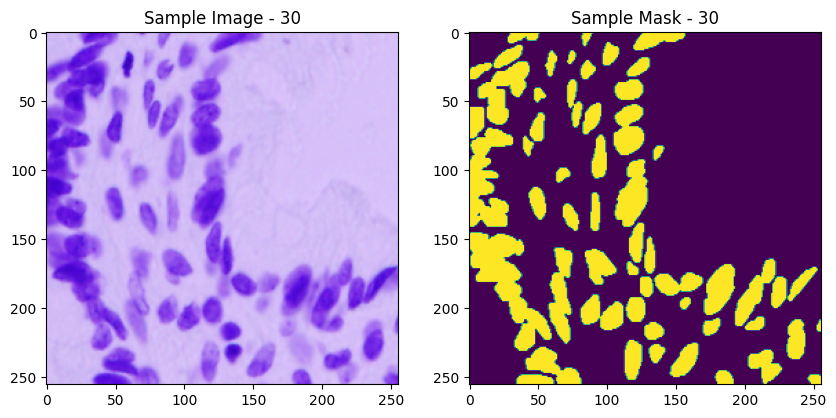

In [ ]:
# hsv_cluster_1_df = trainPD[trainPD['hsv_cluster'] == 1]
# num_cases = hsv_cluster_1_df['image_id'].nunique()
# print('Number of fluorescence microscopy cases: ', num_cases)

# # Retrieving them 
# type_zero_df = trainPD[trainPD['hsv_cluster'] == 1]
# type_zero_ids = type_zero_df['image_id'].tolist()

img_id_full = trainPD['image_id'].tolist()

# Saving original image list and mask list
og_masks = []
og_imgs = []
for i in range(len(img_id_full)):
    img = read_image(img_id_full[i])
    img = cv2.resize(img,(256,256))
    img = (img - np.min(img)) / (np.max(img) - np.min(img))
    og_imgs.append(img)
    _, label, _ = read_image_labels(img_id_full[i])
    label = cv2.resize(label,(256,256))
    label = label/255
    og_masks.append(label)
print('Image Dimensions: ', np.shape(og_imgs),'\n', 'Mask Dimensions: ', np.shape(og_masks))

# Displaying 20 images:
for i in range(10, 30):
  fig, axs = plt.subplots(1, 2, figsize=(10, 5))
  axs[0].imshow(og_imgs[i])
  axs[0].set_title(f'Sample Image - {i+1}')
  axs[1].imshow(og_masks[i])
  axs[1].set_title(f'Sample Mask - {i+1}')
  plt.show()

# Adding Abberations

### Spherical Aberrations

In [ ]:
import numpy as np
from scipy.ndimage import gaussian_filter

def add_spherical_aberration(image, sigma):
    """
    Adds spherical aberration to microscopy image using Fourier transforms.

    Args:
        image (numpy.ndarray): 3D RGB microscopy image.
        sigma (float): Standard deviation of Gaussian kernel used to add aberration.

    Returns:
        numpy.ndarray: 3D RGB microscopy image with added spherical aberration.
    """
    # Convert image to frequency domain
    f_image = np.fft.fft2(image, axes=(0, 1))

    # Get meshgrid of Fourier space coordinates
    u, v = np.meshgrid(np.fft.fftfreq(image.shape[1]), np.fft.fftfreq(image.shape[0]))

    # Calculate radial distance from center of Fourier space
    r = np.sqrt((u**2) + (v**2))

    # Create aberration function as a Gaussian kernel in Fourier space
    aberration = np.exp(-(r**2) / (2 * sigma**2))

    # Multiply image Fourier transform by aberration function for each color channel
    f_aberrated = np.zeros_like(f_image)
    for i in range(image.shape[-1]):
        f_aberrated[..., i] = f_image[..., i] * aberration

    # Convert back to spatial domain
    aberrated_image = np.fft.ifft2(f_aberrated, axes=(0, 1)).real

    # Smooth out the added aberration with a Gaussian filter for each color channel
    channels = [gaussian_filter(aberrated_image[..., i], sigma) for i in range(image.shape[-1])]
    aberrated_image = np.stack(channels, axis=-1)
    aberrated_image = (aberrated_image - aberrated_image.min()) / (aberrated_image.max() - aberrated_image.min())
    return aberrated_image


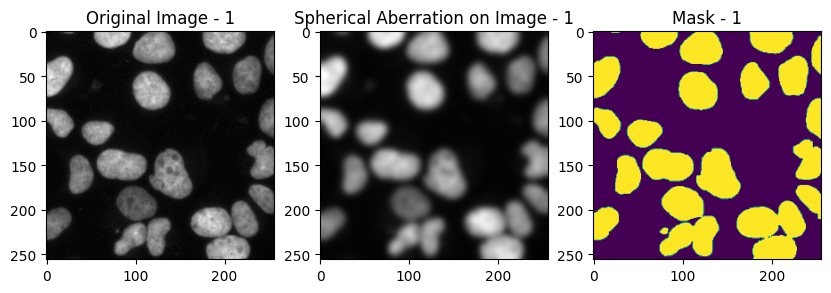

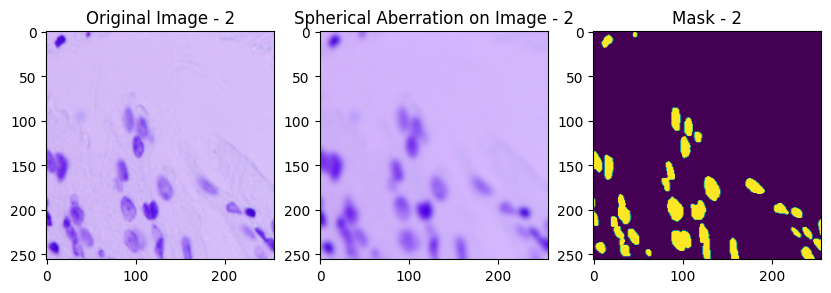

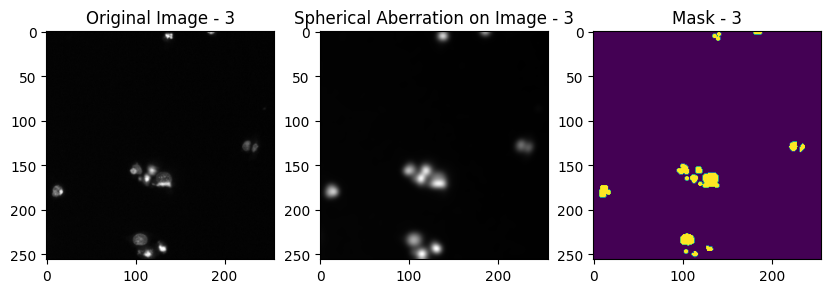

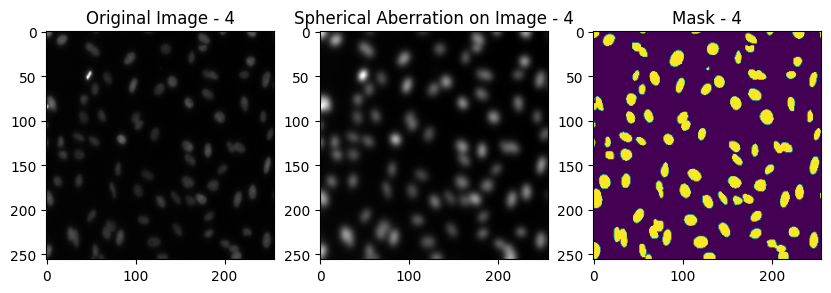

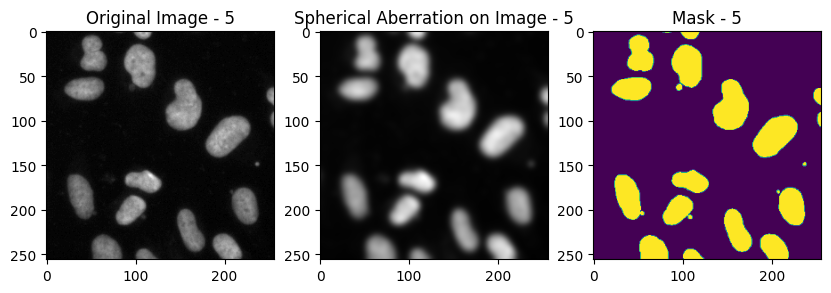

In [ ]:
# Adding spherical aberrations to images:
sa_images = []
for i in range(len(og_imgs)):
    img = add_spherical_aberration(og_imgs[i], 3)
    sa_images.append(img)
    
for i in range(5):
  fig, axs = plt.subplots(1, 3, figsize=(10, 5))
  axs[0].imshow(og_imgs[i])
  axs[0].set_title(f'Original Image - {i+1}')
  axs[1].imshow(sa_images[i])
  axs[1].set_title(f'Spherical Aberration on Image - {i+1}')
  axs[2].imshow(og_masks[i])
  axs[2].set_title(f'Mask - {i+1}')
  plt.show()

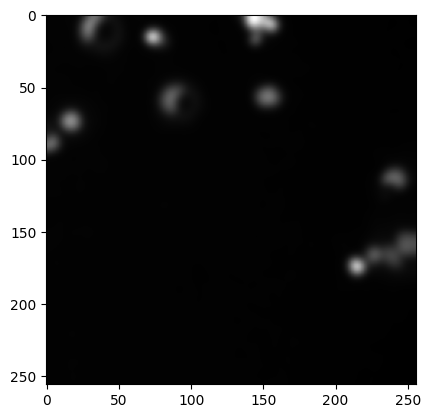

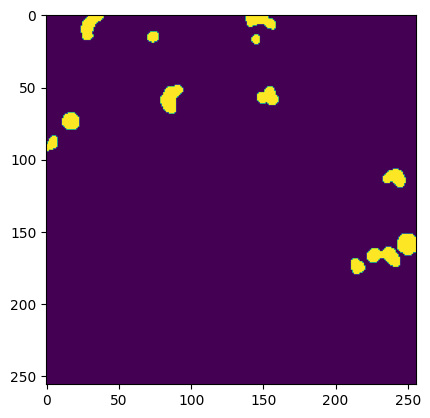

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Load the original dataset
X = np.asarray(sa_images) # (100, height, width, channels)
y = np.asarray(og_masks) # (100, height, width, 1)

# Split the dataset into training and testing sets
split = int(len(sa_images)*0.8)
X_train = X[:split]
y_train = y[:split]
X_test = X[split:]
y_test = y[split:]

# # Set aside 100 images for validation
# X_val = X_train[-100:]
# y_val = y_train[-100:]
# X_train = X_train[:-100]
# y_train = y_train[:-100]

# Define the data augmentation parameters
datagen = ImageDataGenerator(
    rotation_range=10,
    horizontal_flip=True,
    vertical_flip=True,
)

# Generate additional training data until we have __ images
while len(X_train) < 100:
    # Generate one batch of augmented data
    batch_X, batch_y = next(datagen.flow(X_train, y_train, batch_size=80))
    # Add the augmented data to the training set
    X_train = np.concatenate([X_train, batch_X])
    y_train = np.concatenate([y_train, batch_y])

# Generate additional testing data until we have 100 images
while len(X_test) < 50:
    # Generate one batch of augmented data
    batch_X, batch_y = next(datagen.flow(X_test, y_test, batch_size=20))
    # Add the augmented data to the testing set
    X_test = np.concatenate([X_test, batch_X])
    y_test = np.concatenate([y_test, batch_y])

plt.figure()
plt.imshow(X_train[0])
plt.figure()
plt.imshow(y_train[0])

# METRICS AND LOSS FUNCTION

In [ ]:
# Define IoU metric
def mean_iou(y_true, y_pred):
    prec = []
    for t in np.arange(0.5, 1.0, 0.05):
        y_pred_ = tf.to_int32(y_pred > t)
        score, up_opt = tf.metrics.mean_iou(y_true, y_pred_, 2)
        K.get_session().run(tf.local_variables_initializer())
        with tf.control_dependencies([up_opt]):
            score = tf.identity(score)
        prec.append(score)
    return K.mean(K.stack(prec), axis=0)
  
def jacard_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (intersection + 1.0) / (K.sum(y_true_f) + K.sum(y_pred_f) - intersection + 1.0)


def jacard_coef_loss(y_true, y_pred):
    return -jacard_coef(y_true, y_pred)  # -1 multiplied as we want to minimize this value as loss function

miou = MeanIoU(num_classes=1)

import tensorflow as tf

def dice_loss(y_true, y_pred, smooth=1e-7):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    dice_coef = (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)
    dice_loss = 1. - dice_coef
    return dice_loss


def dice_coef(y_true, y_pred, smooth=1e-7):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    dice_coef = (2. * intersection + smooth) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + smooth)
    return dice_coef

# Defining Model with Physical Layer

# CASE 1: Training aberrated images without physical layer

In [ ]:
# Model
def unet(pretrained_weights = None,input_size = (256, 256, 3)):
    inputs = Input(input_size)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(inputs)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    drop1 = tf.keras.layers.Dropout(0.1)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(drop1)
    
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv2)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    drop2 = tf.keras.layers.Dropout(0.1)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(drop2)
    
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    drop3 = tf.keras.layers.Dropout(0.2)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(drop3)
    
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv4)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    drop4 = tf.keras.layers.Dropout(0.2)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    drop5 = tf.keras.layers.Dropout(0.3)(conv5)

    up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop5))
    merge6 = tf.keras.layers.concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    drop6 = tf.keras.layers.Dropout(0.2)(conv6)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop6))
    merge7 = tf.keras.layers.concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    drop7 = tf.keras.layers.Dropout(0.2)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop7))
    merge8 = tf.keras.layers.concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    drop8 = tf.keras.layers.Dropout(0.1)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop8))
    merge9 = tf.keras.layers.concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(2, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    drop9 = tf.keras.layers.Dropout(0.1)(conv9)
    
    conv10 = Conv2D(1, 1, activation = 'sigmoid')(drop9)

    model = Model(inputs = inputs, outputs = conv10)
    
    adam=tf.keras.optimizers.Adam( learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

    model.compile(optimizer = adam, loss = ['binary_crossentropy'], metrics = ['accuracy', dice_coef])
    
    model.summary()
    
    return model


In [ ]:
# # checkpointer = tf.keras.callbacks.ModelCheckpoint('unetIOU6.h5', verbose=1, save_best_only=True)
earlystopper = tf.keras.callbacks.EarlyStopping(patience = 5, monitor='val_loss')
# lr_callback = tf.keras.callbacks.LearningRateScheduler(lr_scheduler)
# # tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [ earlystopper]
##############
model = unet()
##############
results = model.fit(X_train, y_train
                    , batch_size=8
                    , epochs=50
#                     , validation_data=(x_val, y_val)
                    , validation_split=0.3
                    , shuffle=True
                    # , validation_data=(X_val, Y_val)
                    # , use_multiprocessing=True
                    , verbose = 1)

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 256, 256, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 256, 256, 64  256        ['conv2d[0][0]']                 
 alization)                     )                                                             

In [ ]:
model.save('no_physical.h5')

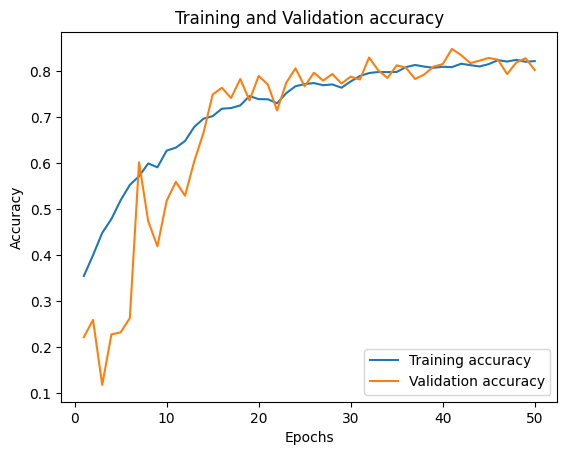

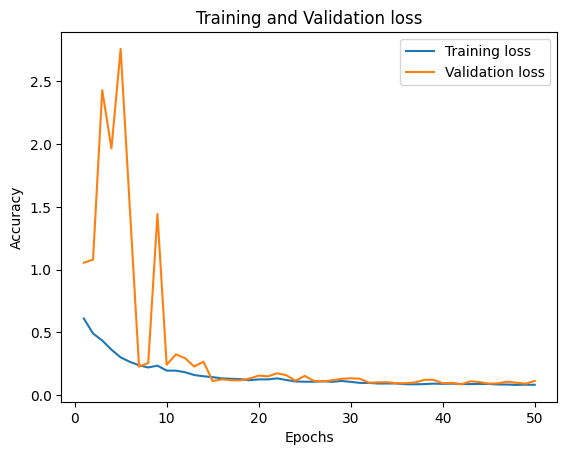

In [ ]:
train_acc = results.history['dice_coef']
val_acc = results.history['val_dice_coef']

# number of epochs
epochs = range(1, len(train_acc) + 1)

# plot the train and validation accuracy
plt.figure()
plt.plot(epochs, train_acc, label='Training accuracy')
plt.plot(epochs, val_acc, label='Validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# plot the train and validation loss
plt.figure()
plt.plot(epochs, results.history['loss'], label='Training loss')
plt.plot(epochs, results.history['val_loss'], label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

5/5 [==============================] - 1s 81ms/step - loss: 0.1007 - accuracy: 0.9588 - dice_coef: 0.7987
[0.1007138043642044, 0.9588285088539124, 0.7987130284309387]
1/1 [==============================] - 0s 411ms/step


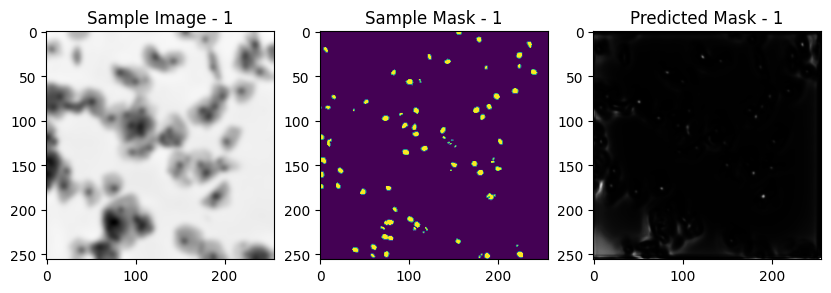

1/1 [==============================] - 0s 24ms/step


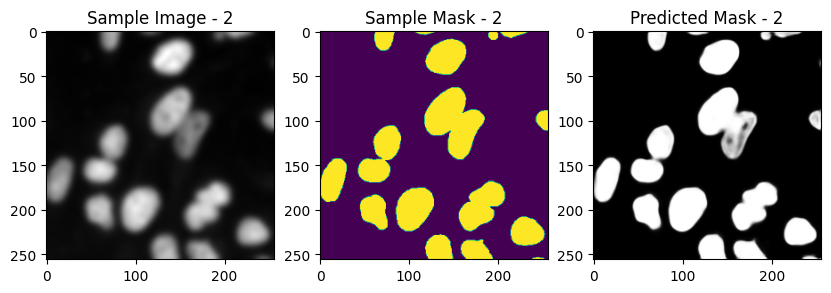

1/1 [==============================] - 0s 24ms/step


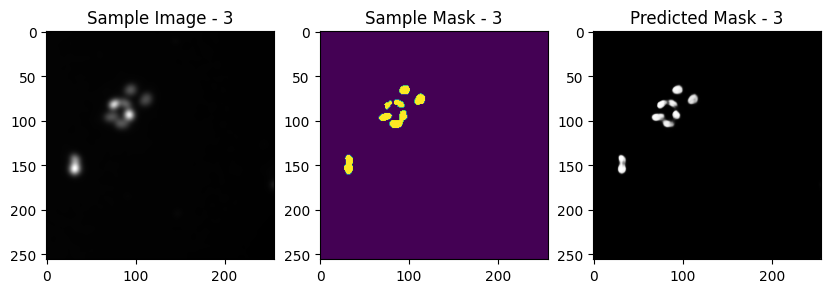

1/1 [==============================] - 0s 24ms/step


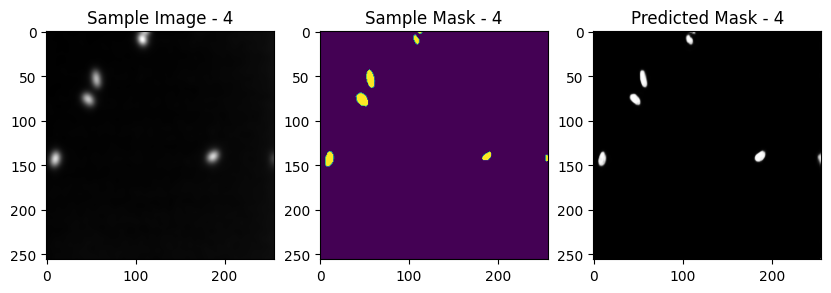

1/1 [==============================] - 0s 24ms/step


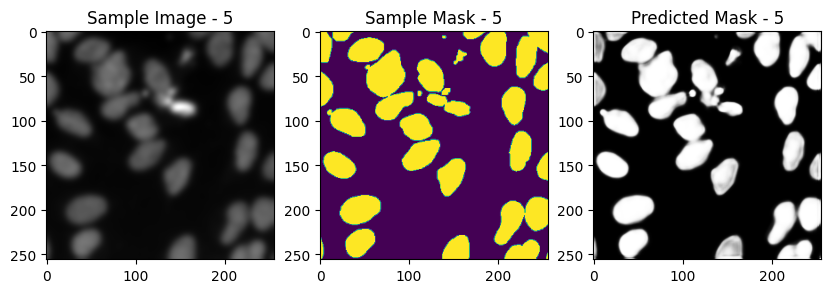

1/1 [==============================] - 0s 24ms/step


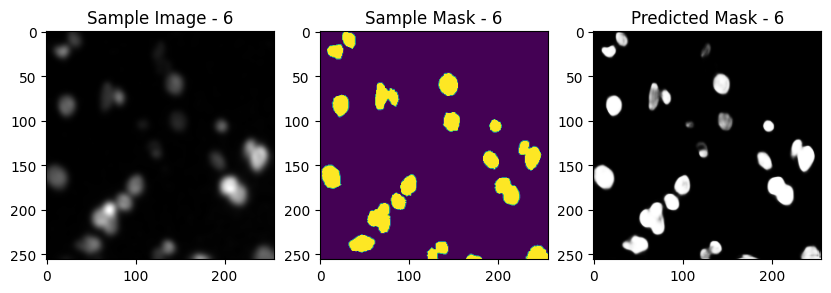

1/1 [==============================] - 0s 24ms/step


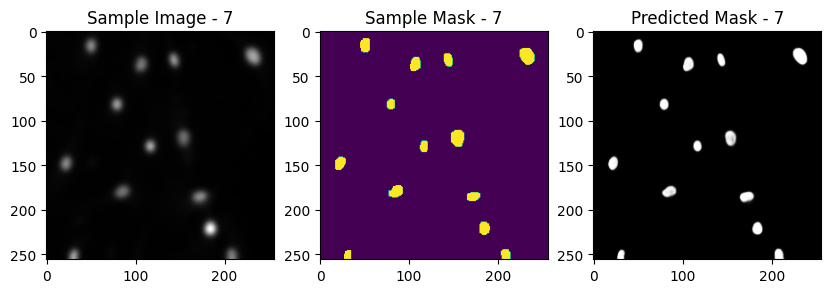

1/1 [==============================] - 0s 24ms/step


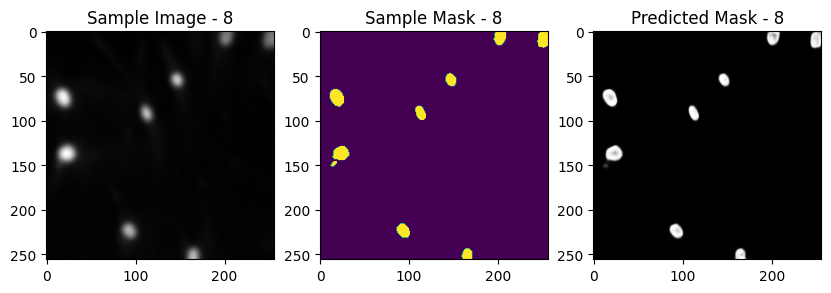

1/1 [==============================] - 0s 23ms/step


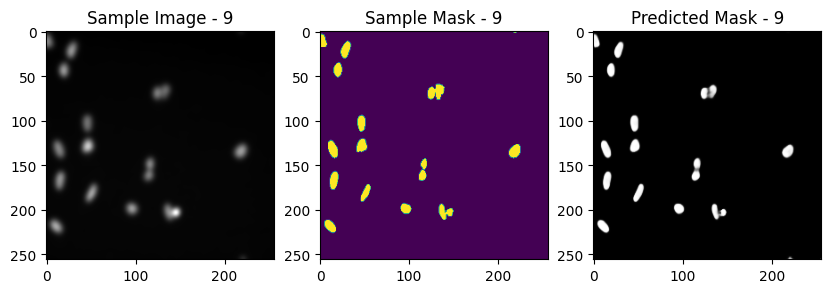

1/1 [==============================] - 0s 25ms/step


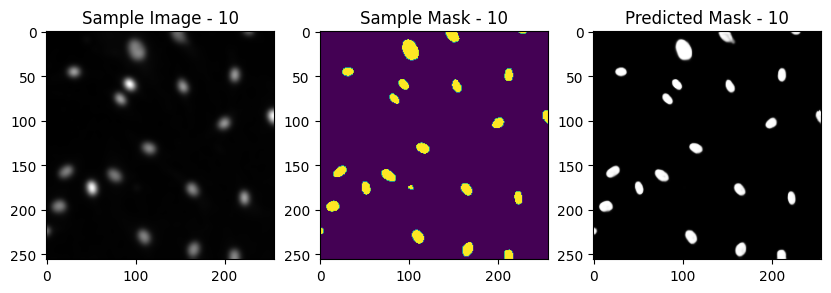

1/1 [==============================] - 0s 24ms/step


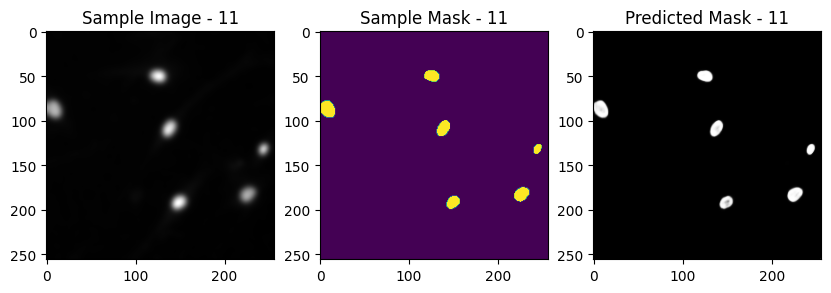

1/1 [==============================] - 0s 23ms/step


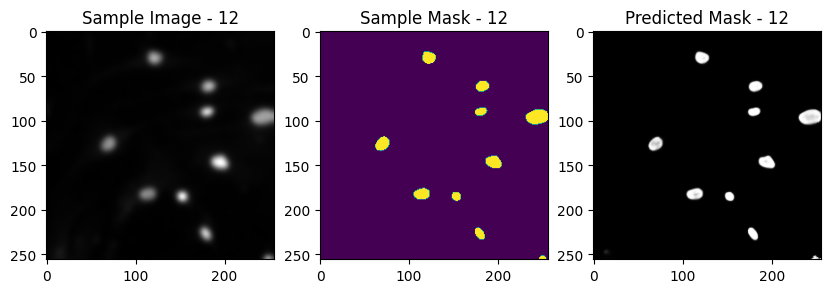

1/1 [==============================] - 0s 24ms/step


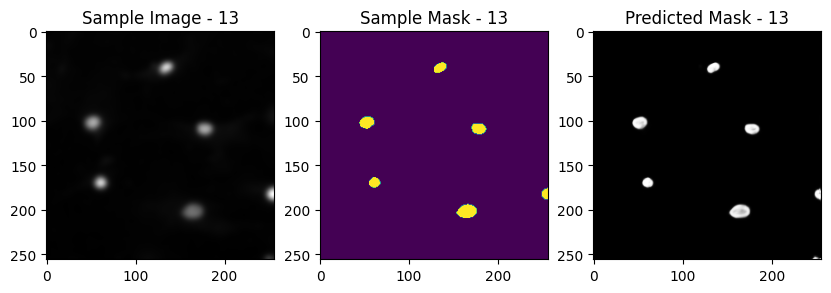

1/1 [==============================] - 0s 25ms/step


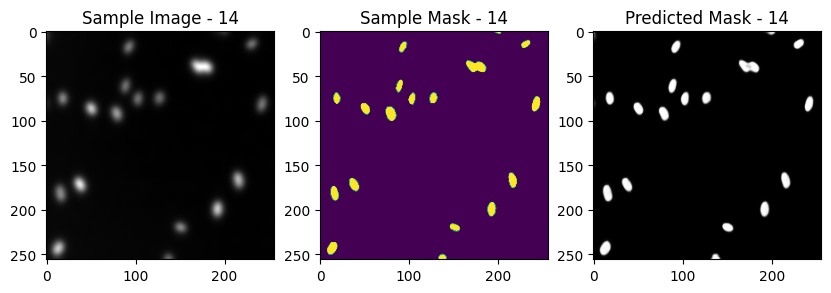

1/1 [==============================] - 0s 23ms/step


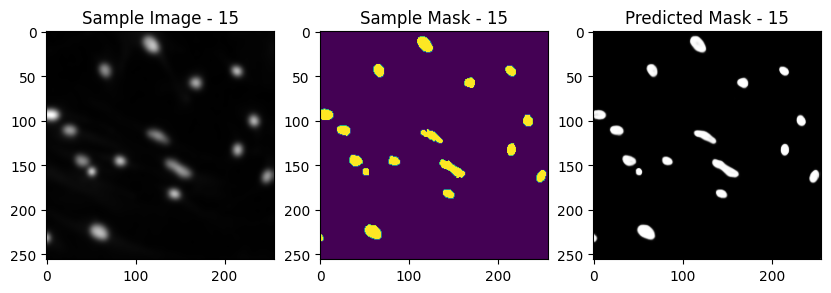

1/1 [==============================] - 0s 23ms/step


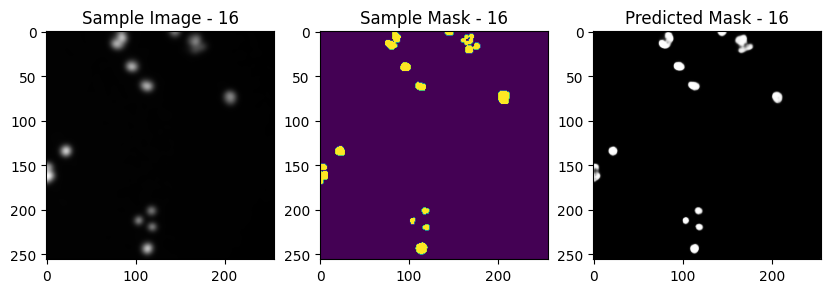

1/1 [==============================] - 0s 23ms/step


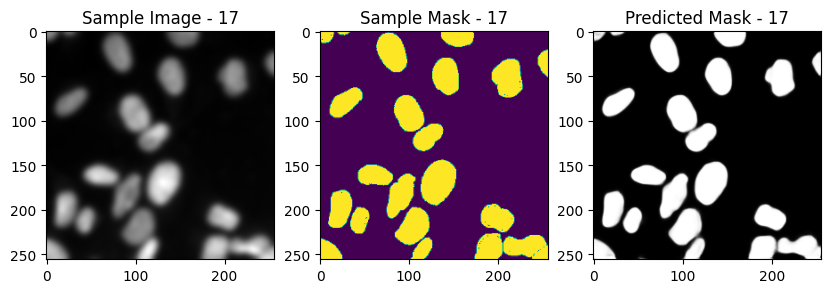

1/1 [==============================] - 0s 24ms/step


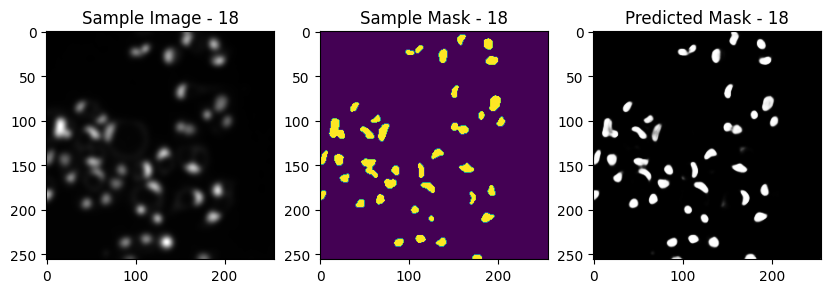

1/1 [==============================] - 0s 24ms/step


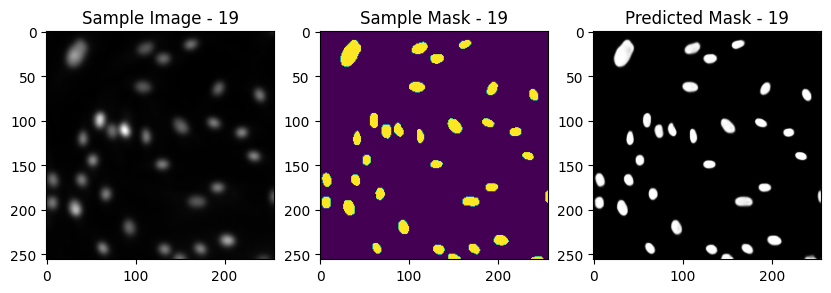

1/1 [==============================] - 0s 24ms/step


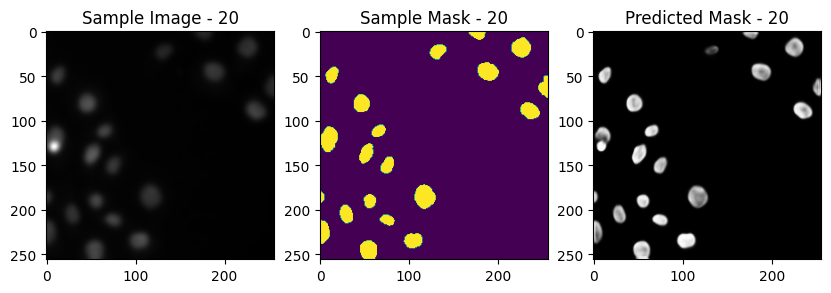

1/1 [==============================] - 0s 24ms/step


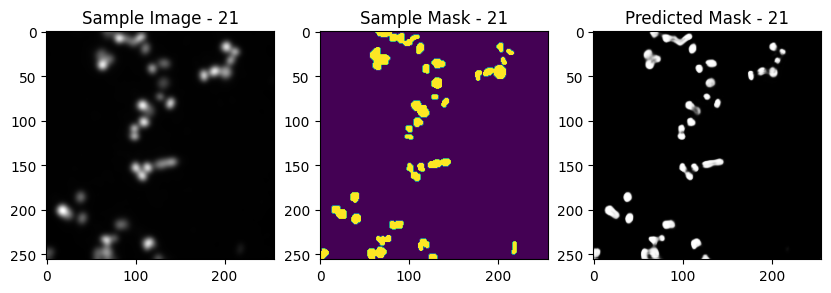

1/1 [==============================] - 0s 24ms/step


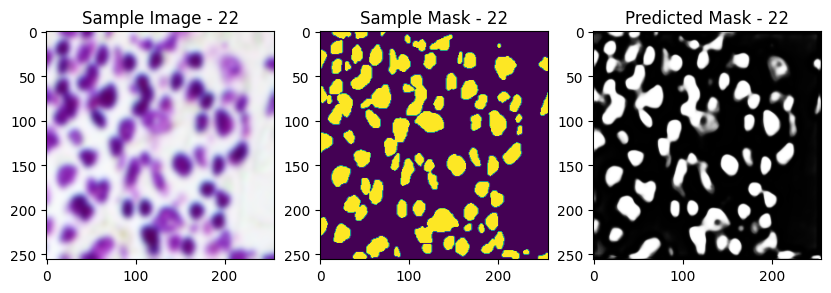

1/1 [==============================] - 0s 23ms/step


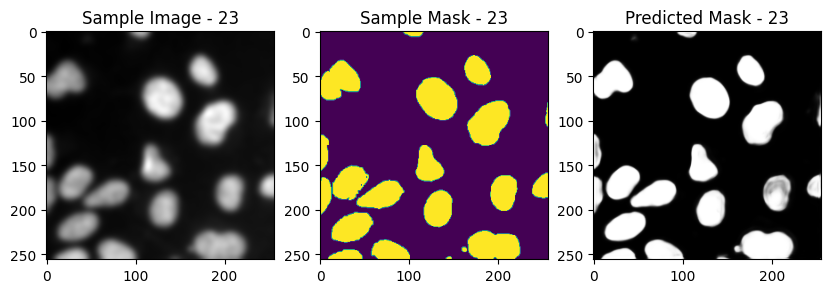

1/1 [==============================] - 0s 24ms/step


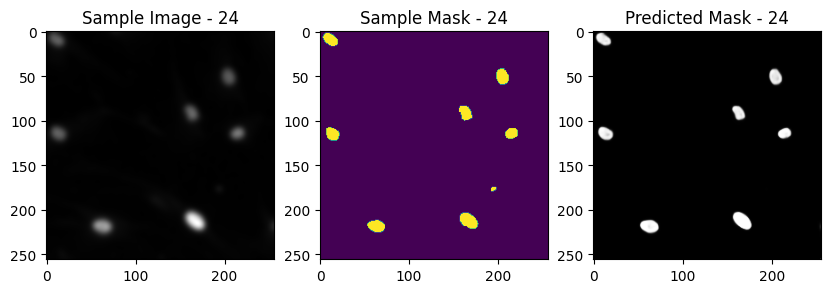

1/1 [==============================] - 0s 24ms/step


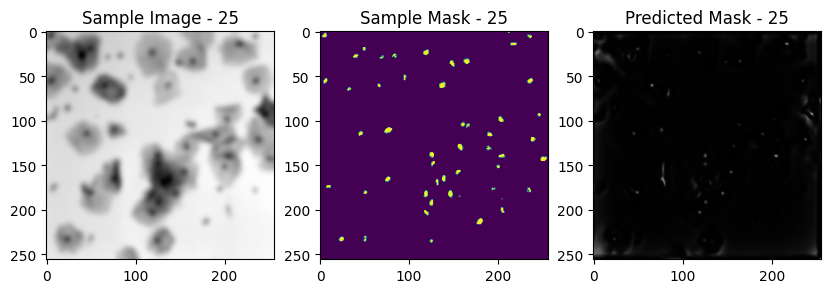

1/1 [==============================] - 0s 24ms/step


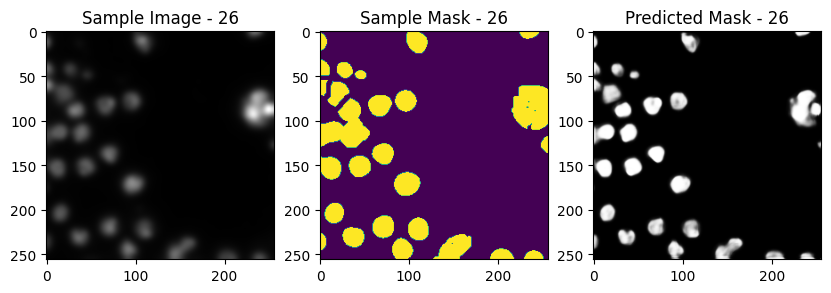

1/1 [==============================] - 0s 23ms/step


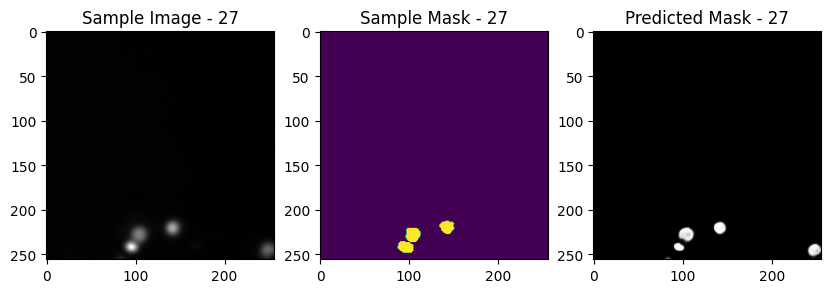

1/1 [==============================] - 0s 24ms/step


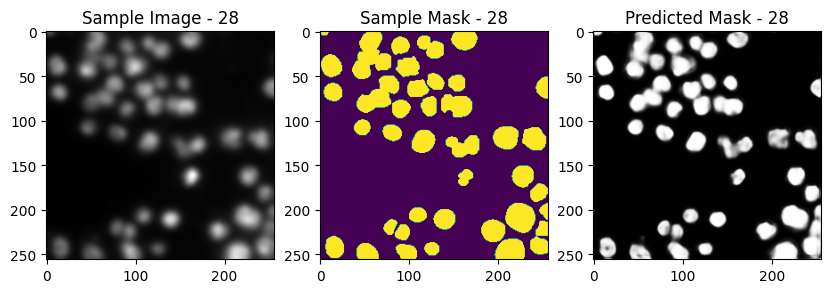

1/1 [==============================] - 0s 23ms/step


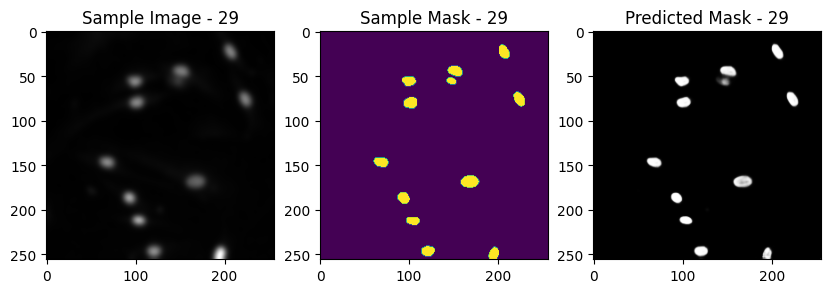

1/1 [==============================] - 0s 23ms/step


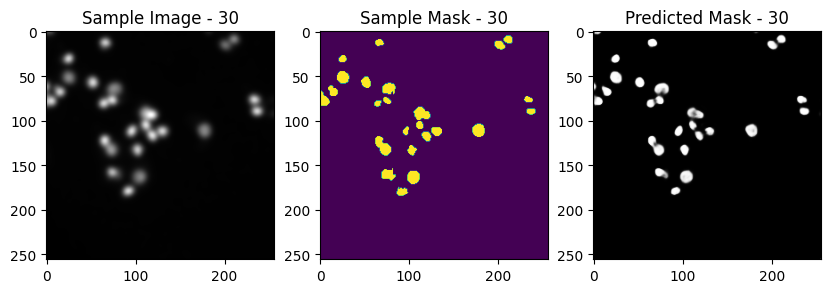

1/1 [==============================] - 0s 23ms/step


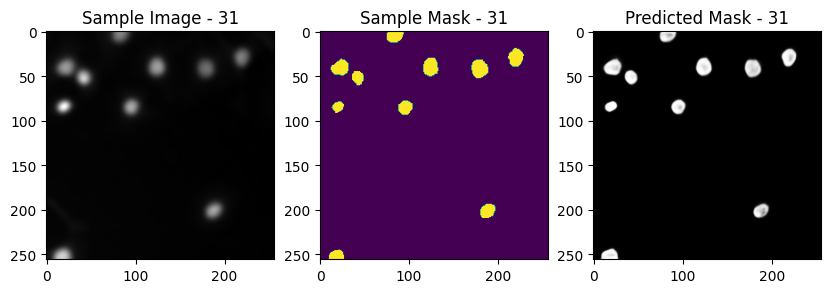

1/1 [==============================] - 0s 23ms/step


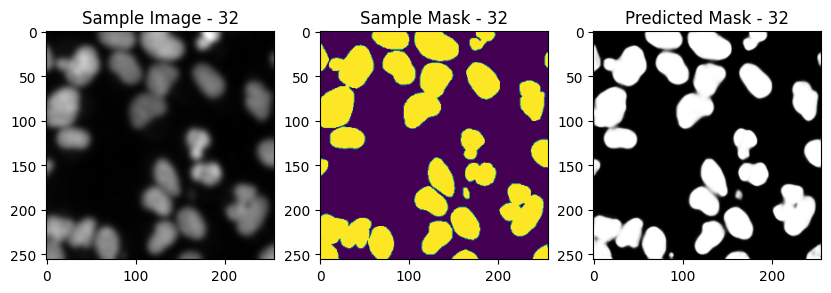

1/1 [==============================] - 0s 24ms/step


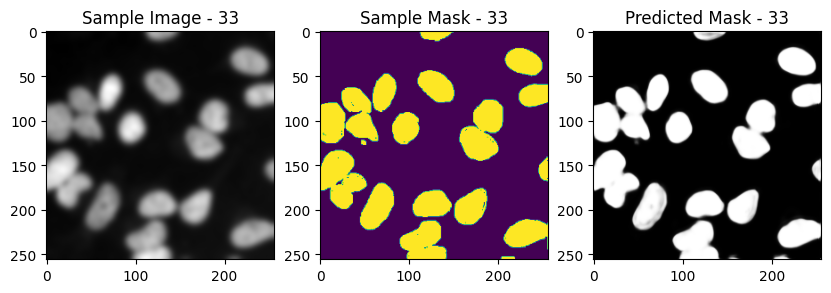

1/1 [==============================] - 0s 23ms/step


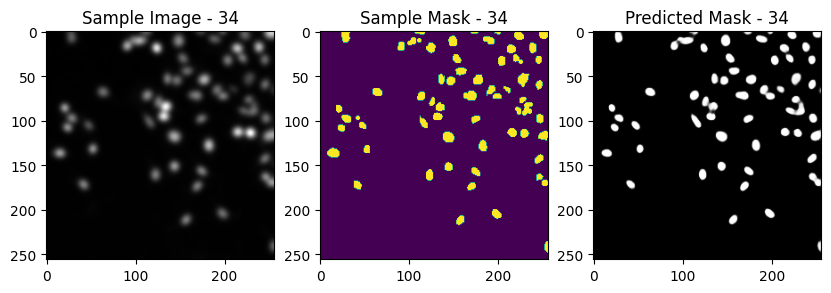

1/1 [==============================] - 0s 23ms/step


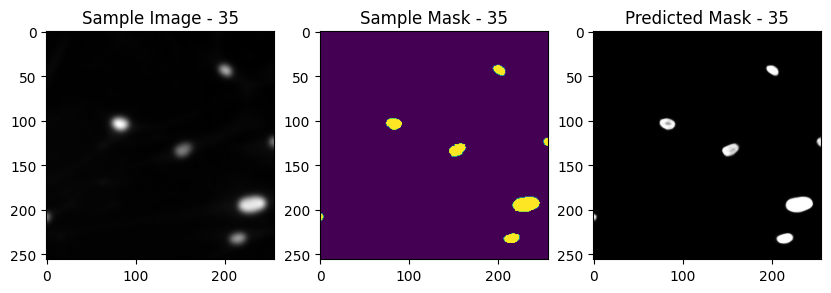

1/1 [==============================] - 0s 25ms/step


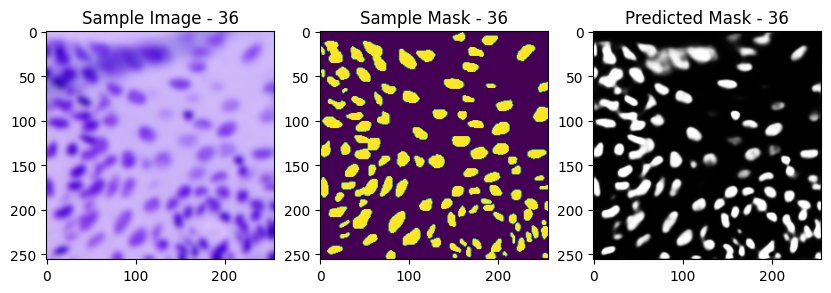

1/1 [==============================] - 0s 24ms/step


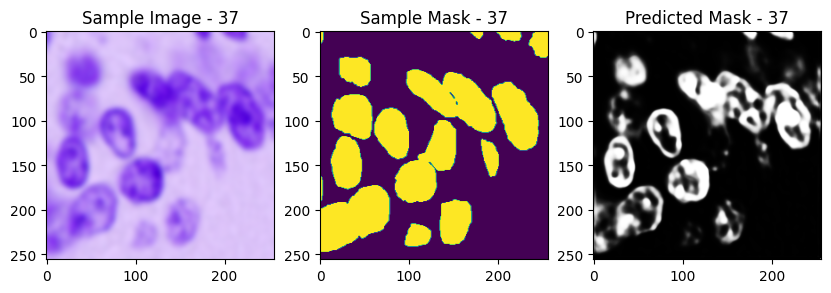

1/1 [==============================] - 0s 24ms/step


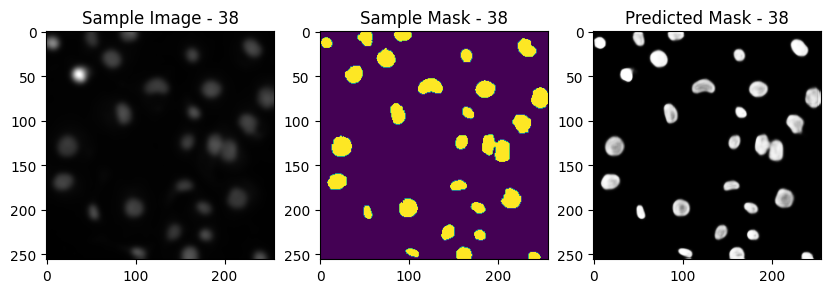

1/1 [==============================] - 0s 24ms/step


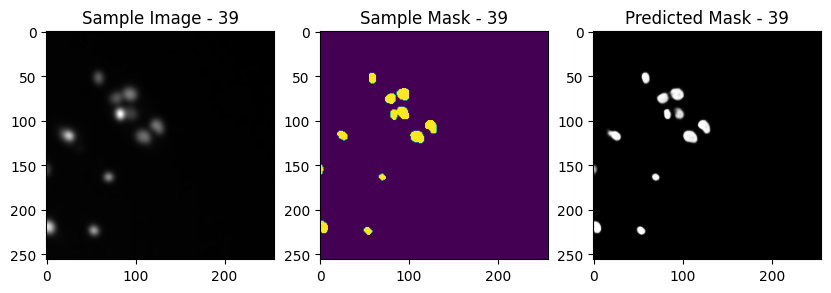

1/1 [==============================] - 0s 24ms/step


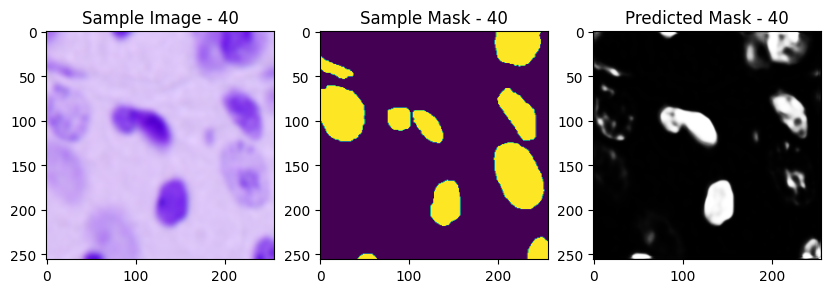

1/1 [==============================] - 0s 24ms/step


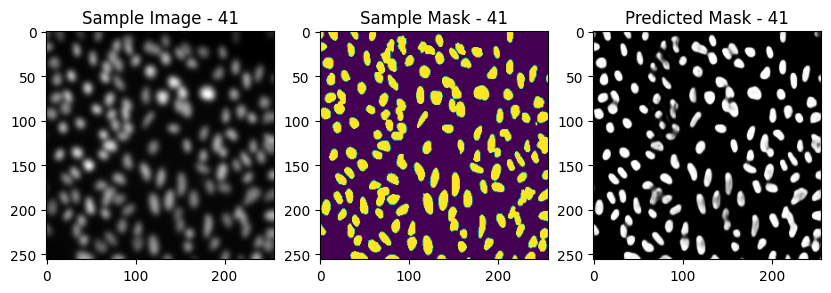

1/1 [==============================] - 0s 23ms/step


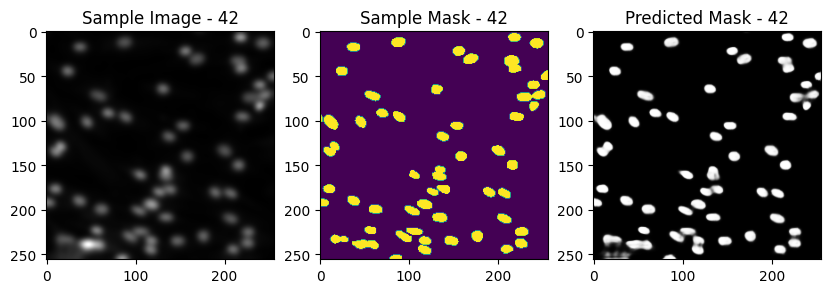

1/1 [==============================] - 0s 23ms/step


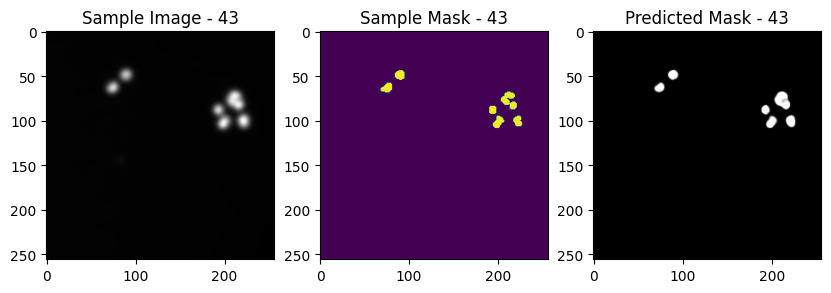

1/1 [==============================] - 0s 23ms/step


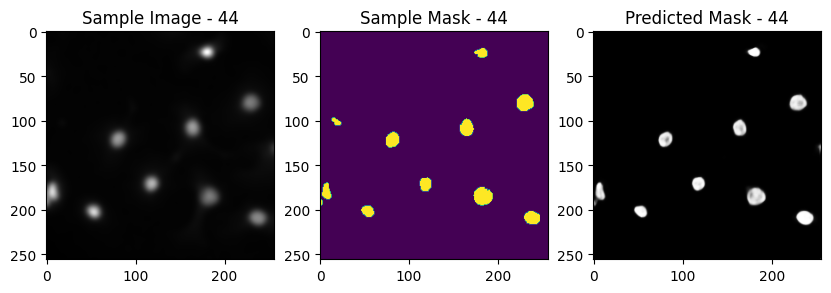

1/1 [==============================] - 0s 23ms/step


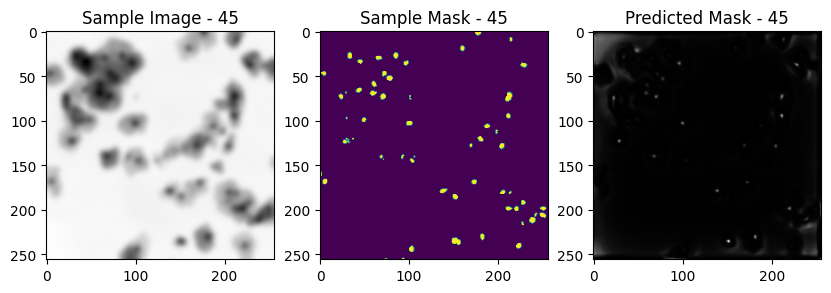

1/1 [==============================] - 0s 23ms/step


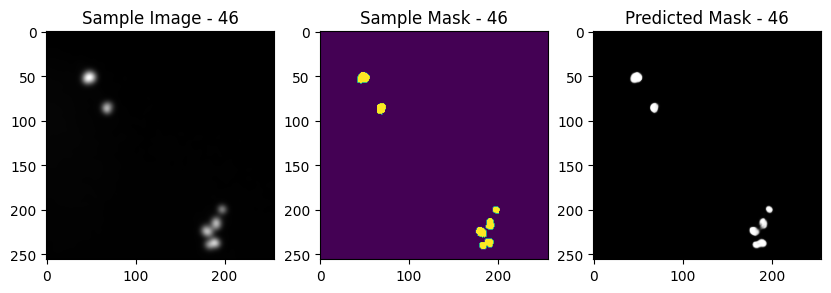

1/1 [==============================] - 0s 24ms/step


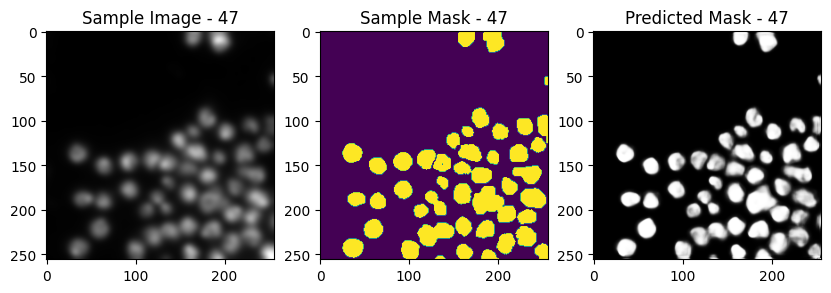

1/1 [==============================] - 0s 24ms/step


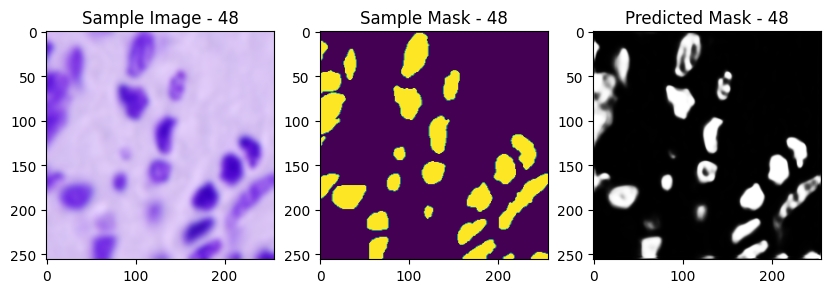

1/1 [==============================] - 0s 23ms/step


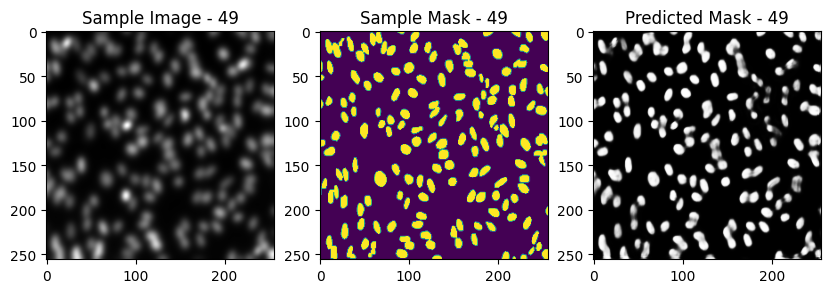

1/1 [==============================] - 0s 24ms/step


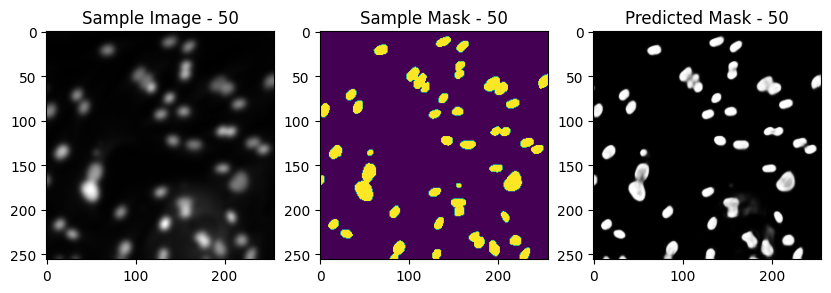

In [ ]:
# load the trained model
model = tf.keras.models.load_model('no_physical.h5',custom_objects={'dice_coef': dice_coef})

# evaluate the model on the test dataset
test_scores = model.evaluate(X_test, y_test)
# loss, accuracy = model.evaluate(test_data)

# print the evaluation results
# print('Test Loss:', loss)
# print('Test Accuracy:', accuracy)
print(test_scores)

for i in range(50):
  fig, axs = plt.subplots(1, 3, figsize=(10, 5))
  axs[0].imshow(X_test[i])
  axs[0].set_title(f'Sample Image - {i+1}')
  axs[1].imshow(y_test[i])
  axs[1].set_title(f'Sample Mask - {i+1}')
  axs[2].imshow(np.squeeze(model.predict(np.expand_dims(X_test[i], axis=0))), cmap='gray')
  axs[2].set_title(f'Predicted Mask - {i+1}')
  plt.show()


# CASE 2: Training aberrated images with physical layer-1

In [ ]:
def tf_fftshift2(A):
    # 2D fftshift
    # apply fftshift to the last two dims
    s = tf.shape(A)
    s1 = s[-2]
    s2 = s[-1]
    A = tf.concat([A[..., s1//2:, :], A[..., :s1//2, :]], axis=-2)
    A = tf.concat([A[..., :, s2//2:], A[..., :, :s2//2]], axis=-1)
    return A
  
def create_rectangular_mask(h, w):
    mask = np.ones((h, w, 3))
    # return np.expand_dims(mask, axis=-1)
    return mask

from tensorflow.keras import layers

class AberrationCorrection(layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self, input_shape):
        h, w, chan = input_shape[1:]
        tensor_mask = tf.constant_initializer(create_rectangular_mask(h, w))
        self.mask = self.add_weight(shape=(h,w,3),
                                    initializer=tensor_mask,
                                    trainable=True)

    def call(self, input):
        # # Applying transpose so that h, w are the last 2 dimensions
        img_t = tf.transpose(input, perm=[0, 3, 1, 2])
        # Applying 2d fft to every channel with shift
        img_fft = tf_fftshift2(tf.signal.fft2d(tf.cast(img_t, tf.complex64)))
        # Element-wise multiplication with the mask
        comp_mask = tf.cast(self.mask, tf.complex64)
        comp_mask = tf.transpose(comp_mask, perm=[2,0,1])
        # print(img_fft.shape, comp_mask.shape)
        img_filtered = img_fft * comp_mask
        # Applying 2D ifft to each channel
        img_ifft = tf.cast(tf_fftshift2(tf.signal.ifft2d(img_filtered)), tf.float32)
        # Taking the absolute value
        img_abs = tf.abs(img_ifft)
        # Transposing back to original axis ordering
        final_img = tf.transpose(img_abs, [0, 2, 3, 1])
        return final_img

In [ ]:
# Model
def unet(pretrained_weights = None,input_size = (256, 256, 3)):
    inputs = Input(input_size)
    x = AberrationCorrection()(inputs)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(x)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    drop1 = tf.keras.layers.Dropout(0.1)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(drop1)
    
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv2)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    drop2 = tf.keras.layers.Dropout(0.1)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(drop2)
    
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    drop3 = tf.keras.layers.Dropout(0.2)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(drop3)
    
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv4)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    drop4 = tf.keras.layers.Dropout(0.2)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    drop5 = tf.keras.layers.Dropout(0.3)(conv5)

    up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop5))
    merge6 = tf.keras.layers.concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    drop6 = tf.keras.layers.Dropout(0.2)(conv6)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop6))
    merge7 = tf.keras.layers.concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    drop7 = tf.keras.layers.Dropout(0.2)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop7))
    merge8 = tf.keras.layers.concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    drop8 = tf.keras.layers.Dropout(0.1)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop8))
    merge9 = tf.keras.layers.concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(2, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    drop9 = tf.keras.layers.Dropout(0.1)(conv9)
    
    conv10 = Conv2D(1, 1, activation = 'sigmoid')(drop9)

    model = Model(inputs = inputs, outputs = conv10)
    
    adam=tf.keras.optimizers.Adam( learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

    model.compile(optimizer = adam, loss = ['binary_crossentropy'], metrics = ['accuracy', dice_coef])
    
    model.summary()
    
    return model


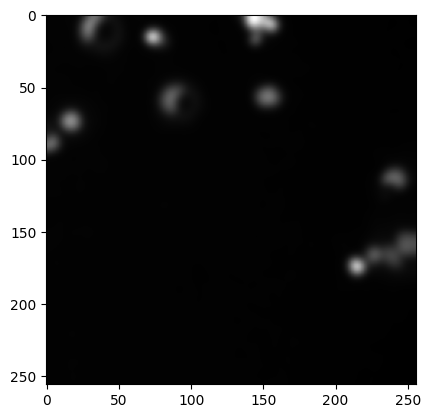

In [ ]:
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

In [ ]:
# # checkpointer = tf.keras.callbacks.ModelCheckpoint('unetIOU6.h5', verbose=1, save_best_only=True)
earlystopper = tf.keras.callbacks.EarlyStopping(patience = 5, monitor='val_loss')
# lr_callback = tf.keras.callbacks.LearningRateScheduler(lr_scheduler)
# # tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [ earlystopper]
##############
model = unet()
##############
results = model.fit(X_train, y_train
                    , batch_size=8
                    , epochs=50
#                     , validation_data=(x_val, y_val)
                    , validation_split=0.3
                    , shuffle=True
                    # , validation_data=(X_val, Y_val)
                    # , use_multiprocessing=True
                    , verbose = 1)

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 aberration_correction (Aberrat  (None, 256, 256, 3)  196608     ['input_2[0][0]']                
 ionCorrection)                                                                                   
                                                                                                  
 conv2d_24 (Conv2D)             (None, 256, 256, 64  1792        ['aberration_correction[0][0]']  
                                )                                                           

47/47 [==============================] - ETA: 0s - loss: 0.6613 - accuracy: 0.6813 - dice_coef: 0.2571

47/47 [==============================] - 21s 124ms/step - loss: 0.6613 - accuracy: 0.6813 - dice_coef: 0.2571 - val_loss: 13.0495 - val_accuracy: 0.1358 - val_dice_coef: 0.2389
Epoch 2/50
47/47 [==============================] - 5s 103ms/step - loss: 0.5294 - accuracy: 0.8482 - dice_coef: 0.3300 - val_loss: 0.5655 - val_accuracy: 0.7465 - val_dice_coef: 0.2073
Epoch 3/50
47/47 [==============================] - 5s 103ms/step - loss: 0.4805 - accuracy: 0.8819 - dice_coef: 0.3541 - val_loss: 0.6166 - val_accuracy: 0.8164 - val_dice_coef: 0.2426
Epoch 4/50
47/47 [==============================] - 5s 102ms/step - loss: 0.4381 - accuracy: 0.8995 - dice_coef: 0.3782 - val_loss: 0.4973 - val_accuracy: 0.8453 - val_dice_coef: 0.2074
Epoch 5/50
47/47 [==============================] - 5s 102ms/step - loss: 0.3989 - accuracy: 0.9114 - dice_coef: 0.3988 - val_loss: 0.4535 - val_accuracy: 0.8427 - val_dice_coef: 0.2194
Epoch 6/50
47/47 [==============================] - 5s 103ms/step - loss: 0.364

In [ ]:
model.save('physical_1.h5')

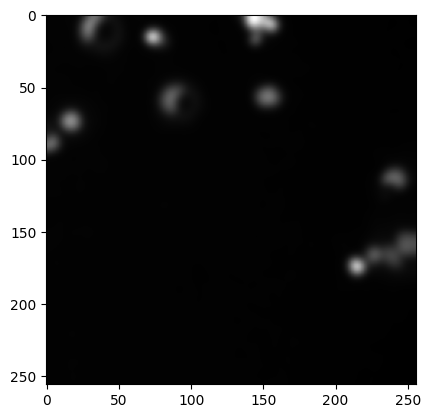

In [ ]:
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

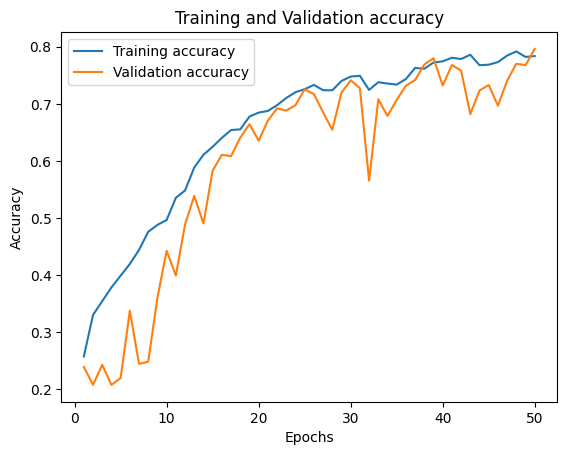

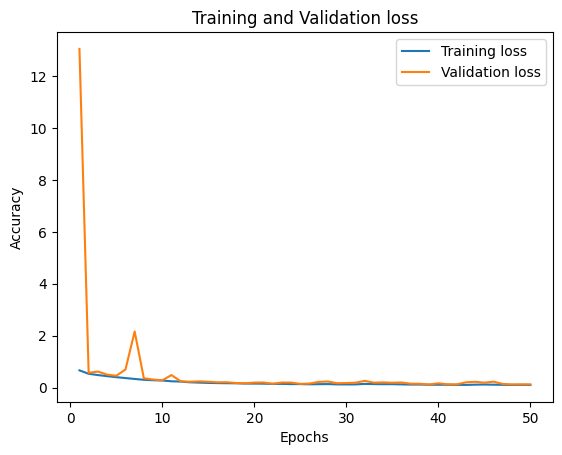

In [ ]:
train_acc = results.history['dice_coef']
val_acc = results.history['val_dice_coef']

# number of epochs
epochs = range(1, len(train_acc) + 1)

# plot the train and validation accuracy
plt.figure()
plt.plot(epochs, train_acc, label='Training accuracy')
plt.plot(epochs, val_acc, label='Validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# plot the train and validation loss
plt.figure()
plt.plot(epochs, results.history['loss'], label='Training loss')
plt.plot(epochs, results.history['val_loss'], label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

5/5 [==============================] - 1s 82ms/step - loss: 0.1223 - accuracy: 0.9508 - dice_coef: 0.7907
[0.12232504040002823, 0.9508090615272522, 0.7906699776649475]


1/1 [==============================] - 1s 517ms/step


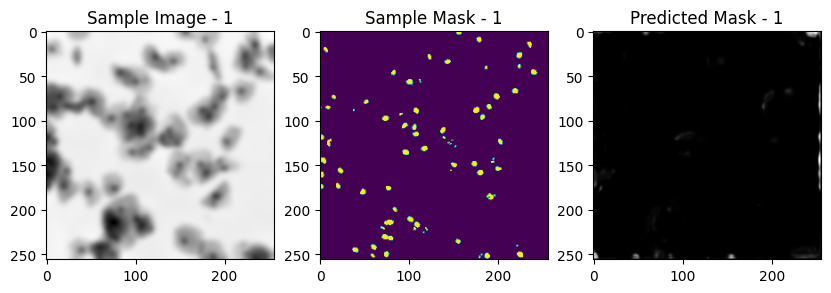

1/1 [==============================] - 0s 24ms/step


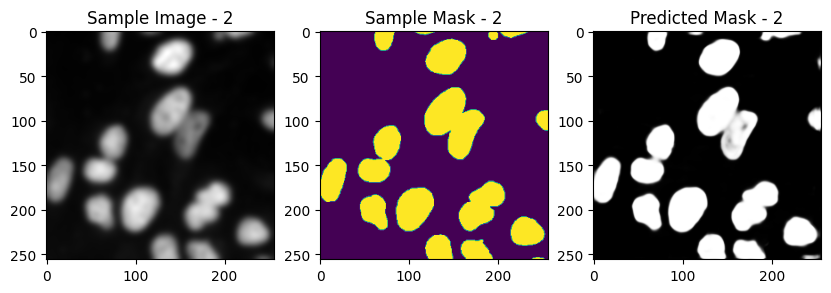

1/1 [==============================] - 0s 23ms/step


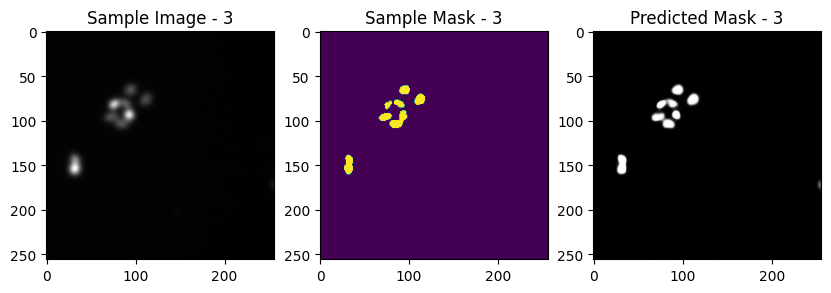

1/1 [==============================] - 0s 23ms/step


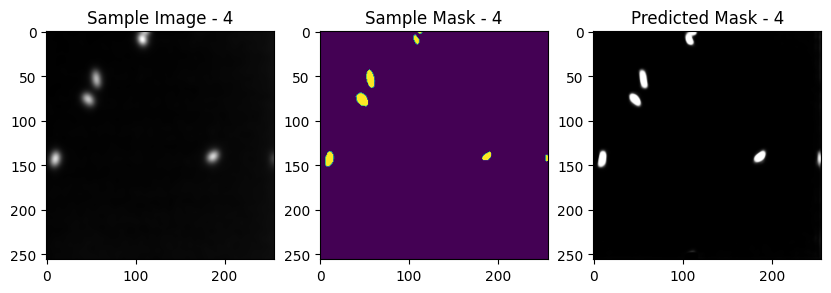

1/1 [==============================] - 0s 23ms/step


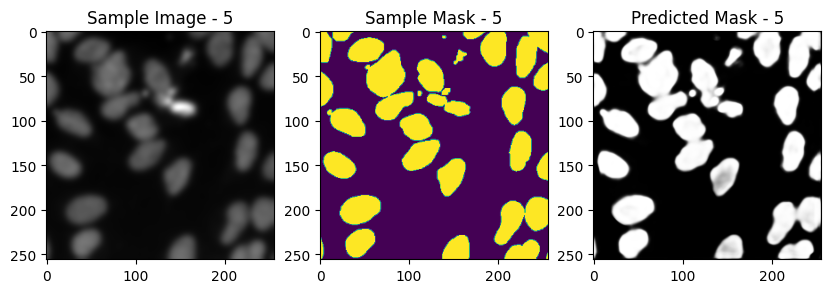

1/1 [==============================] - 0s 23ms/step


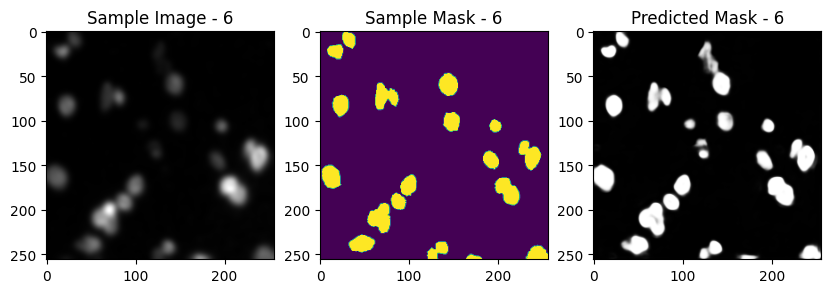

1/1 [==============================] - 0s 23ms/step


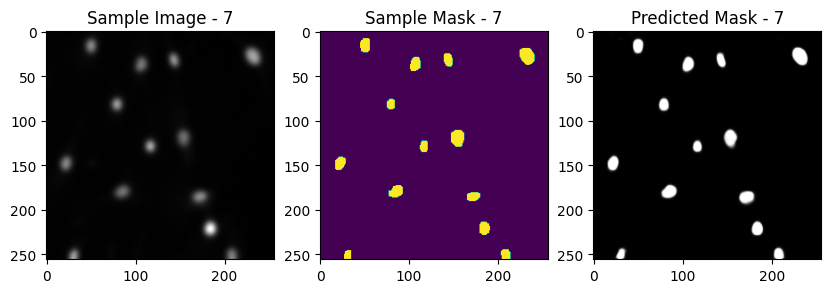

1/1 [==============================] - 0s 23ms/step


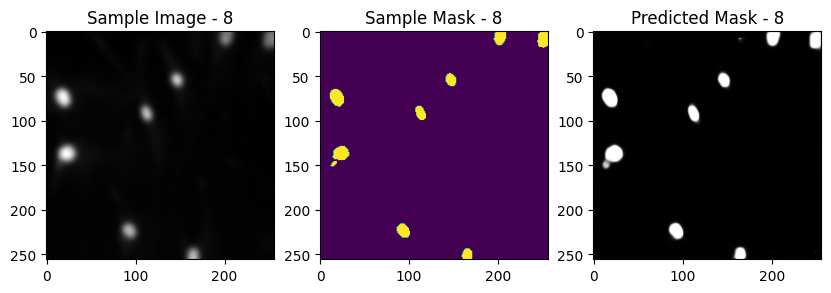

1/1 [==============================] - 0s 23ms/step


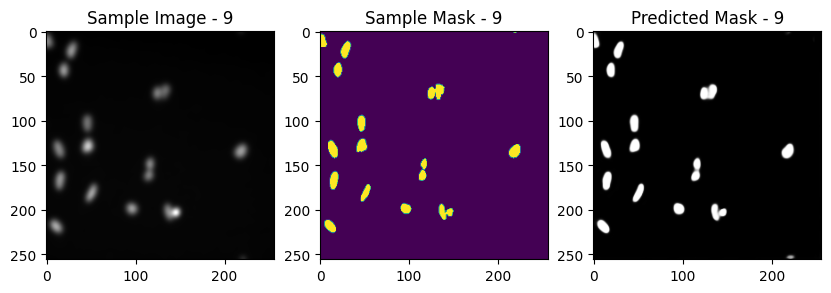

1/1 [==============================] - 0s 23ms/step


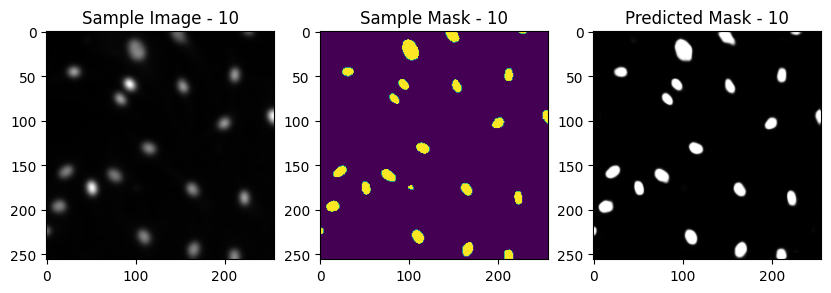

1/1 [==============================] - 0s 23ms/step


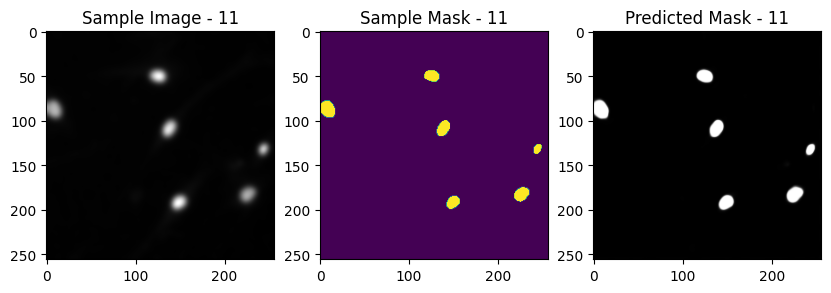

1/1 [==============================] - 0s 23ms/step


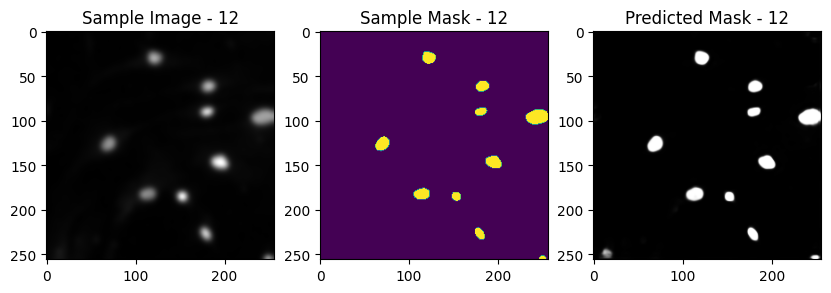

1/1 [==============================] - 0s 24ms/step


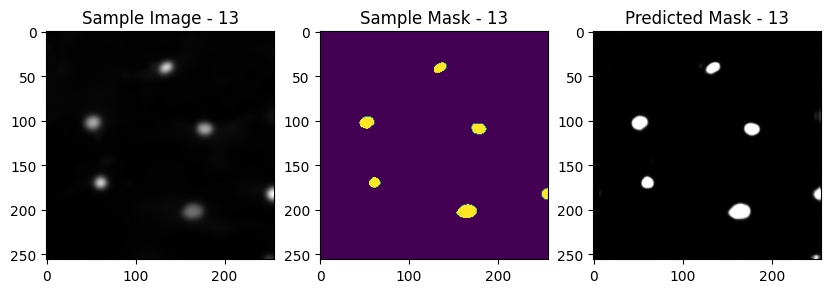

1/1 [==============================] - 0s 23ms/step


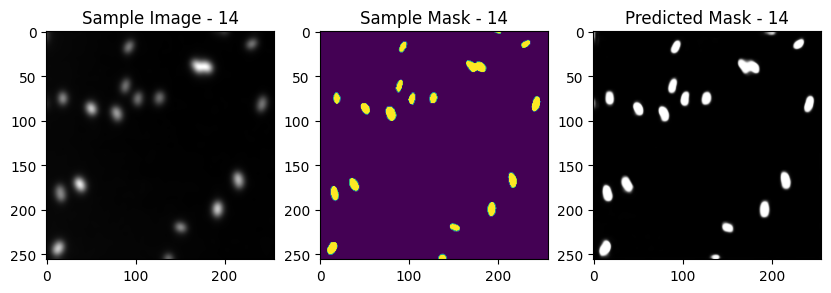

1/1 [==============================] - 0s 23ms/step


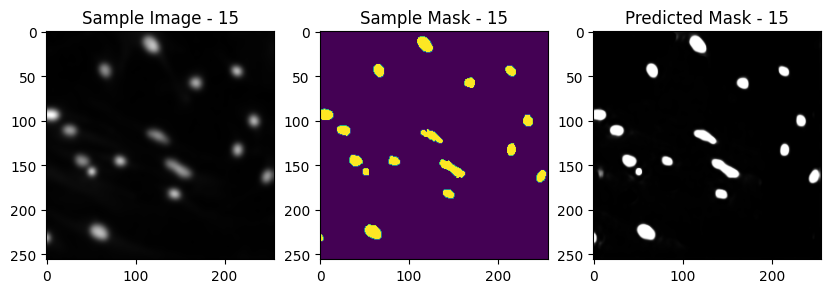

1/1 [==============================] - 0s 23ms/step


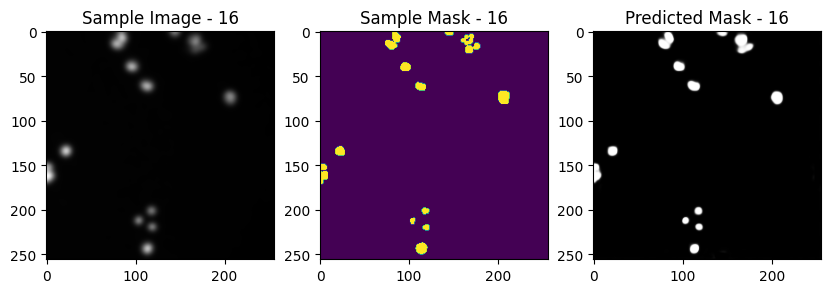

1/1 [==============================] - 0s 26ms/step


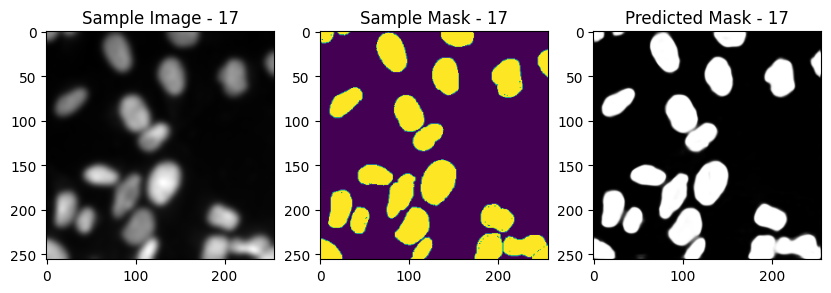

1/1 [==============================] - 0s 25ms/step


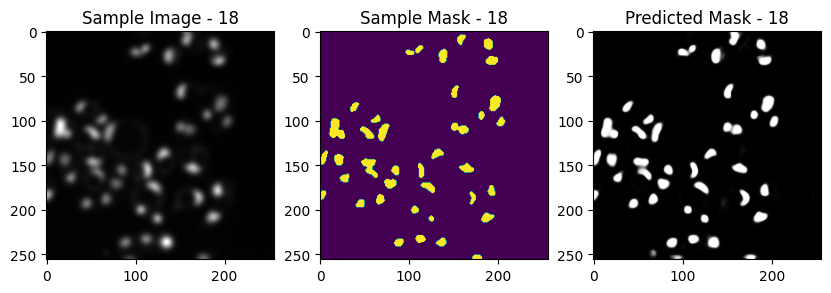

1/1 [==============================] - 0s 24ms/step


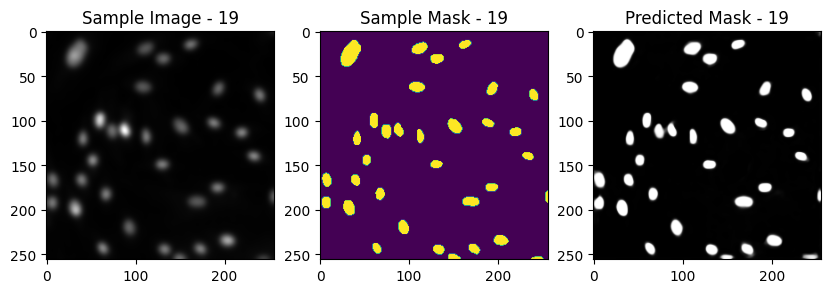

1/1 [==============================] - 0s 24ms/step


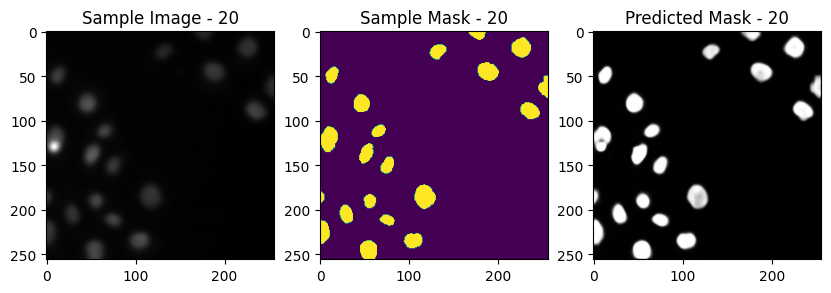

1/1 [==============================] - 0s 23ms/step


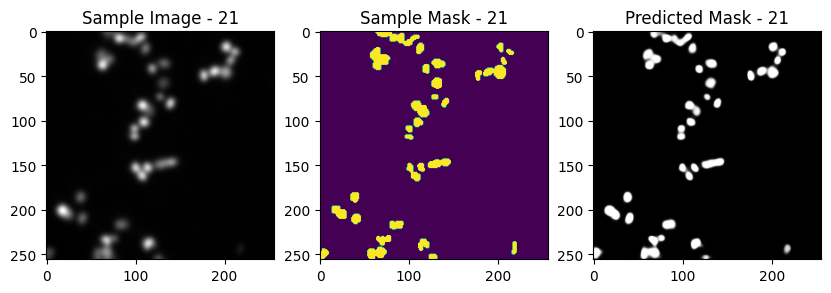

1/1 [==============================] - 0s 24ms/step


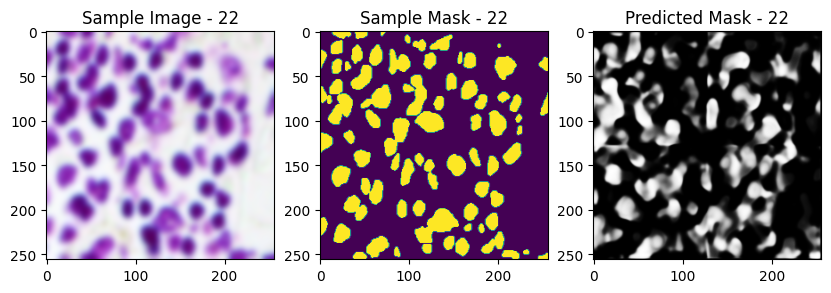

1/1 [==============================] - 0s 24ms/step


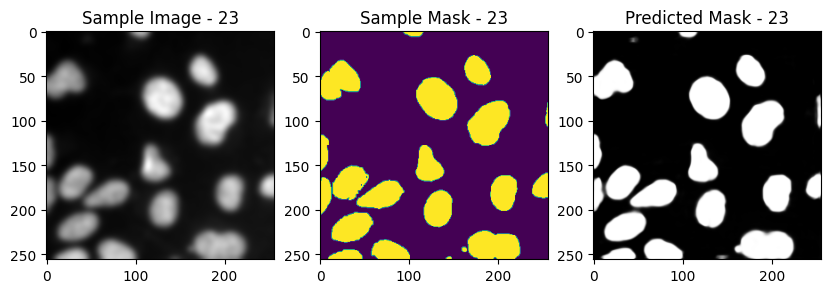

1/1 [==============================] - 0s 23ms/step


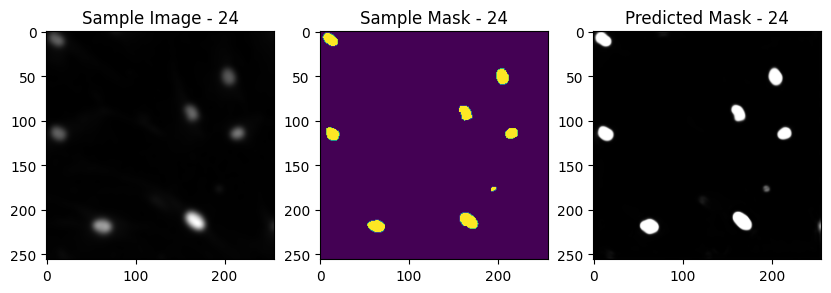

1/1 [==============================] - 0s 23ms/step


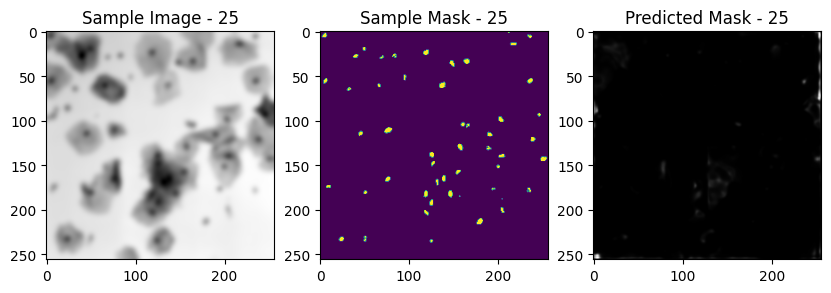

1/1 [==============================] - 0s 23ms/step


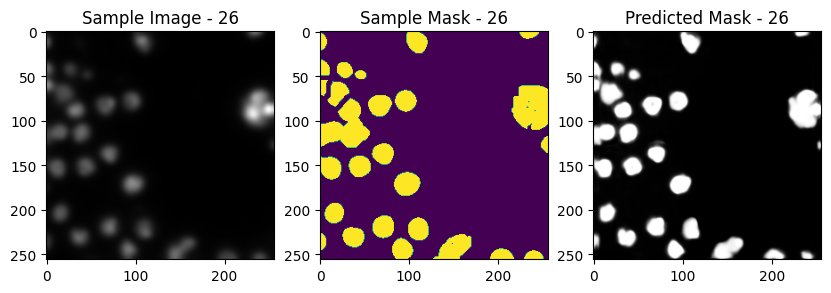

1/1 [==============================] - 0s 24ms/step


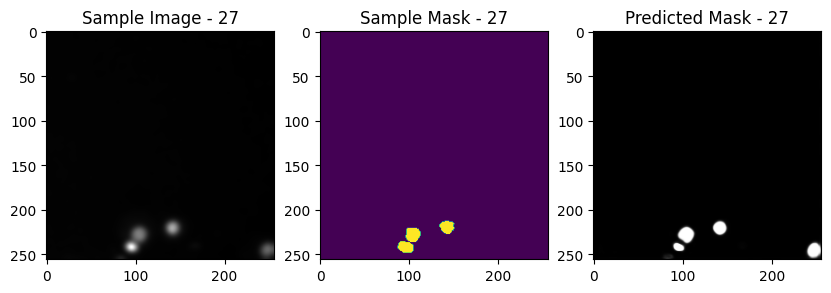

1/1 [==============================] - 0s 25ms/step


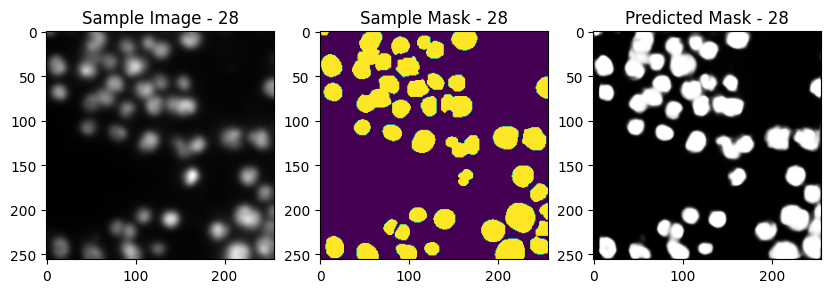

1/1 [==============================] - 0s 23ms/step


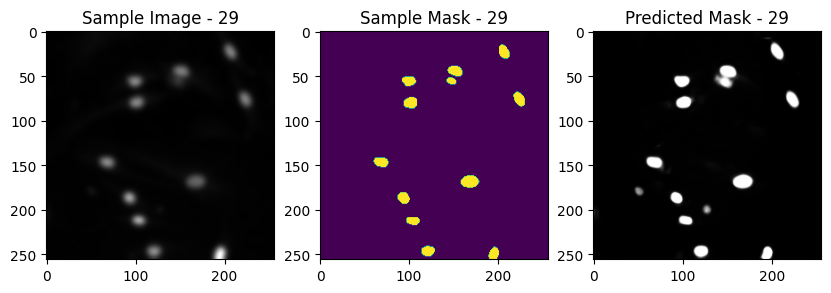

1/1 [==============================] - 0s 23ms/step


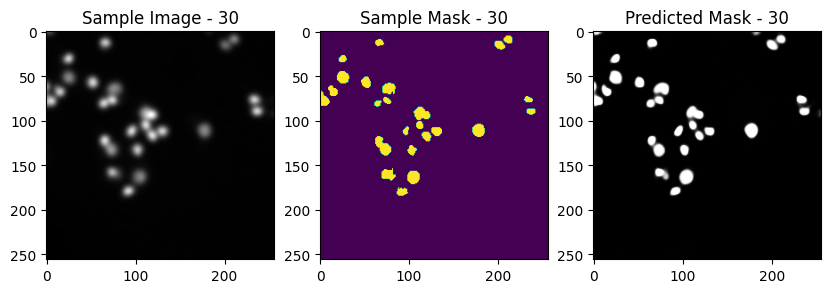

1/1 [==============================] - 0s 23ms/step


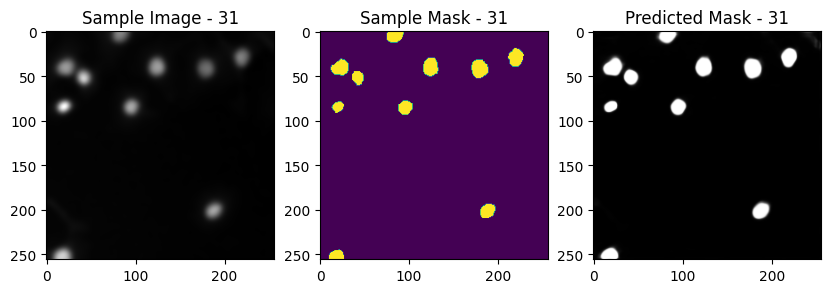

1/1 [==============================] - 0s 23ms/step


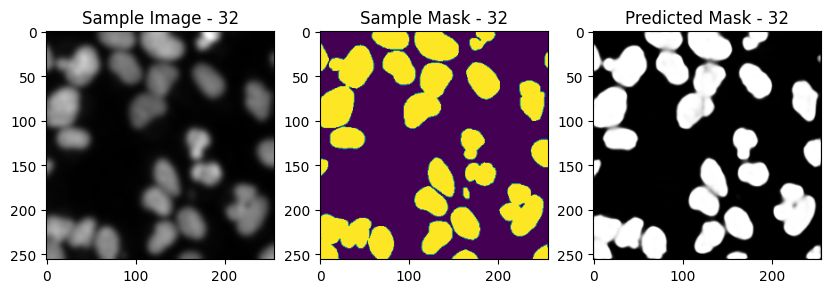

1/1 [==============================] - 0s 23ms/step


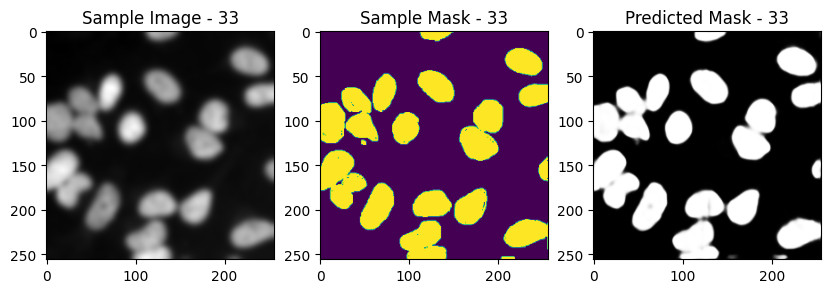

1/1 [==============================] - 0s 24ms/step


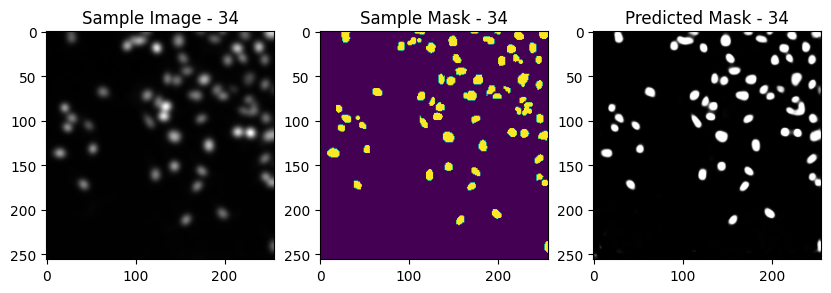

1/1 [==============================] - 0s 24ms/step


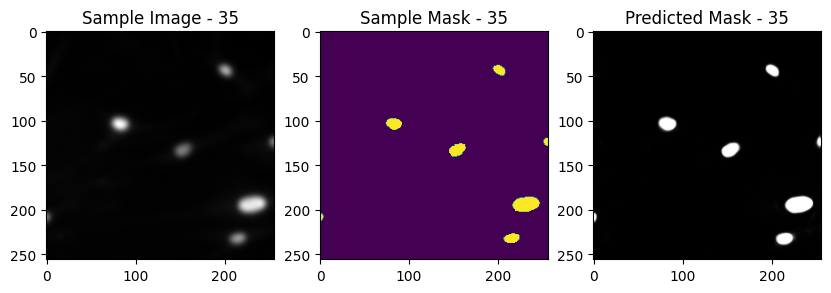

1/1 [==============================] - 0s 24ms/step


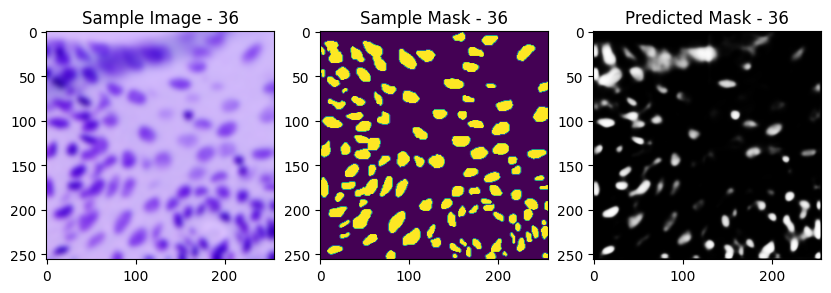

1/1 [==============================] - 0s 25ms/step


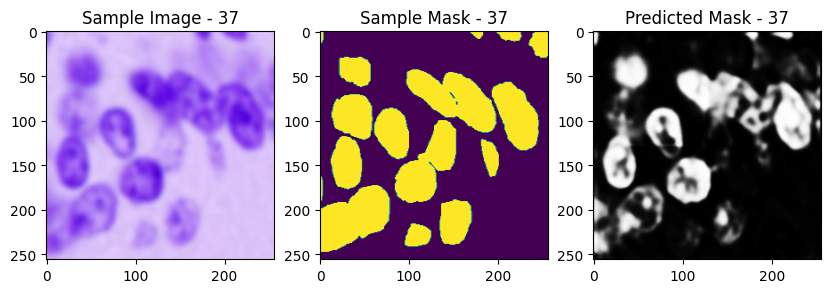

1/1 [==============================] - 0s 24ms/step


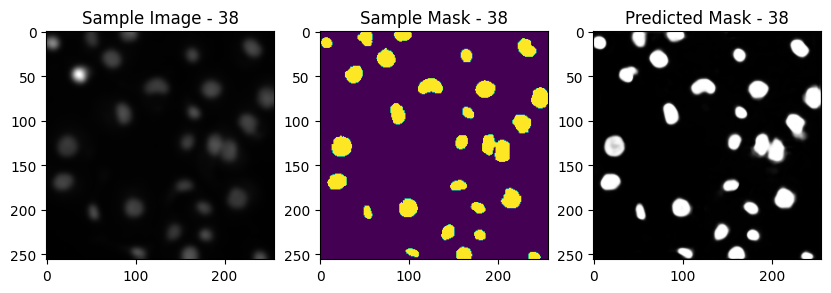

1/1 [==============================] - 0s 25ms/step


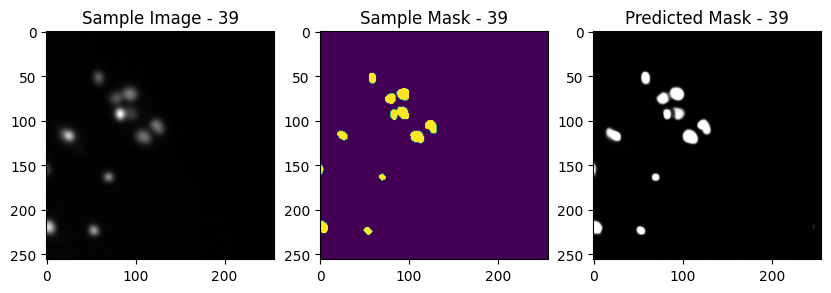

1/1 [==============================] - 0s 24ms/step


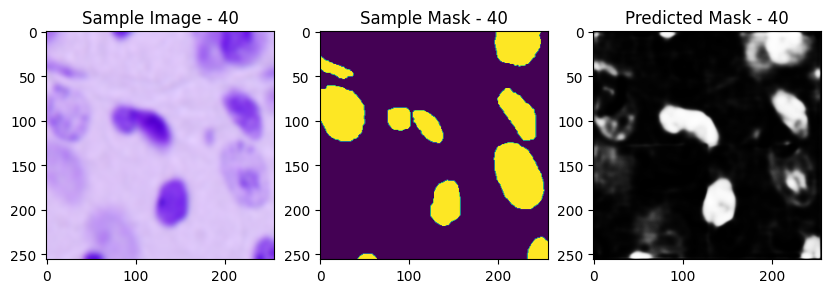

1/1 [==============================] - 0s 24ms/step


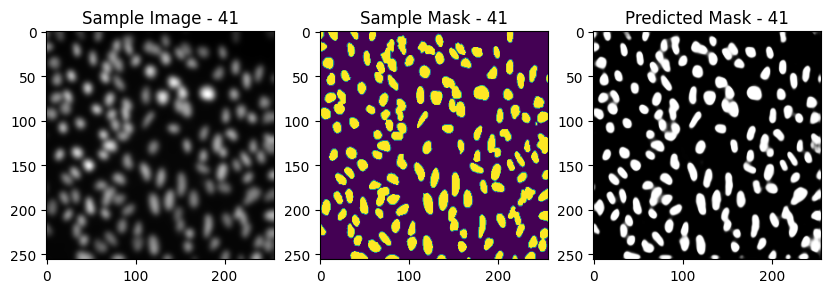

1/1 [==============================] - 0s 23ms/step


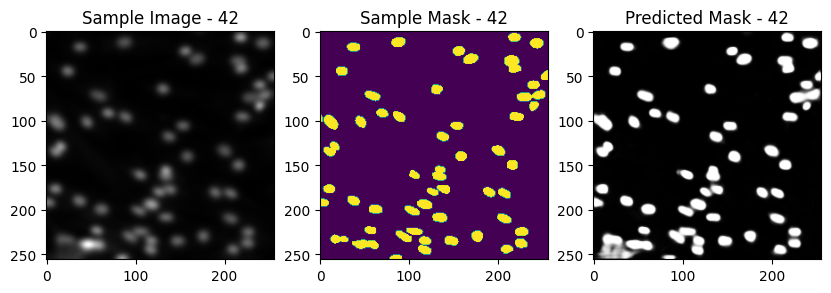

1/1 [==============================] - 0s 23ms/step


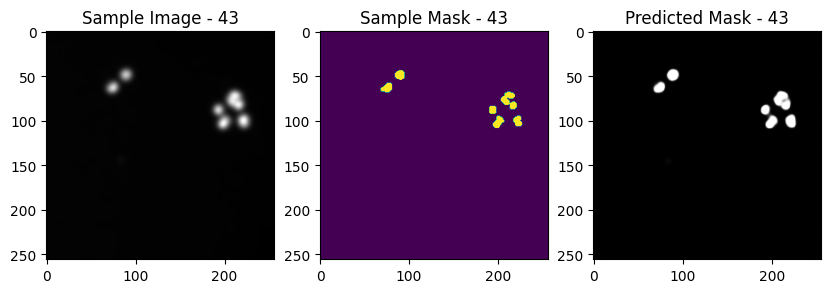

1/1 [==============================] - 0s 23ms/step


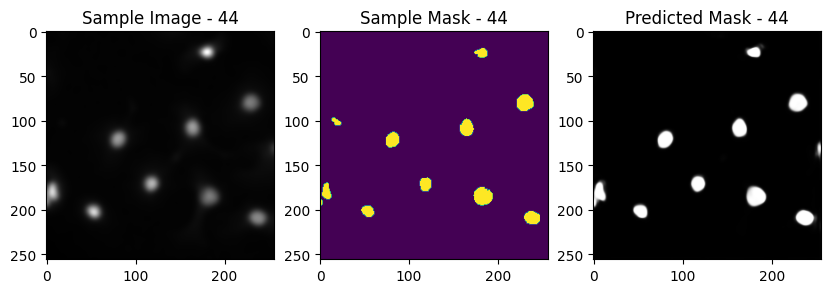

1/1 [==============================] - 0s 23ms/step


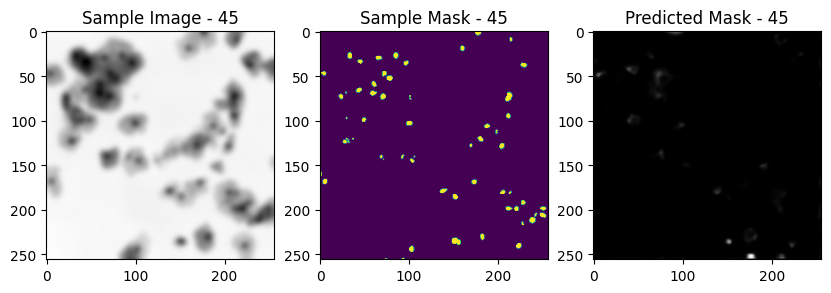

1/1 [==============================] - 0s 24ms/step


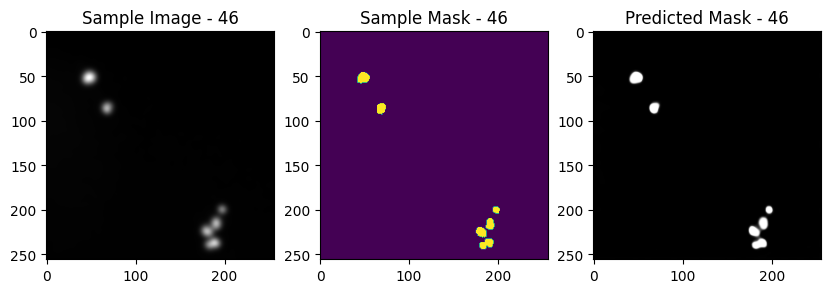

1/1 [==============================] - 0s 23ms/step


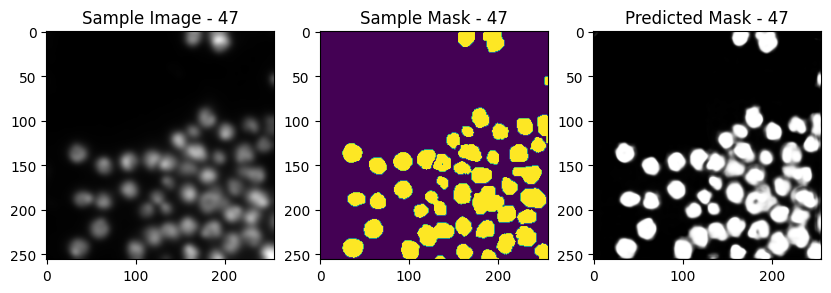

1/1 [==============================] - 0s 23ms/step


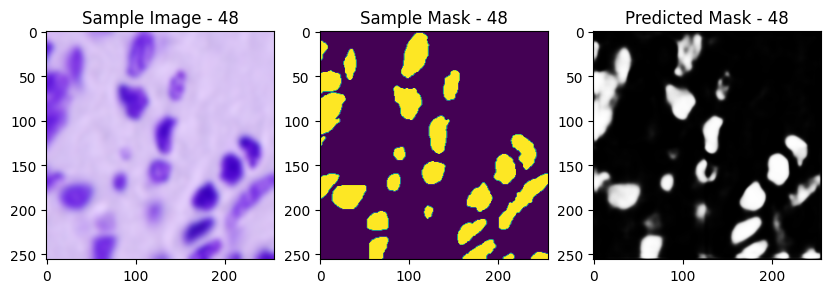

1/1 [==============================] - 0s 24ms/step


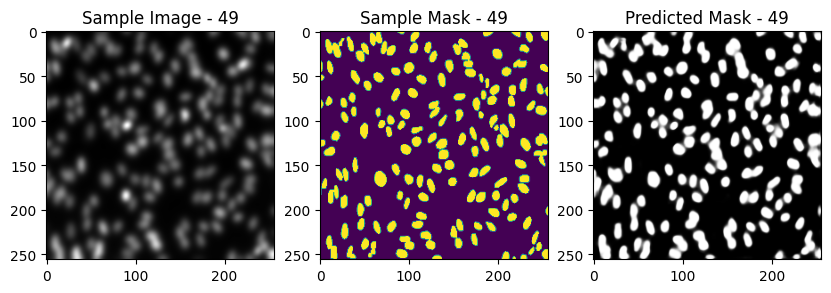

1/1 [==============================] - 0s 23ms/step


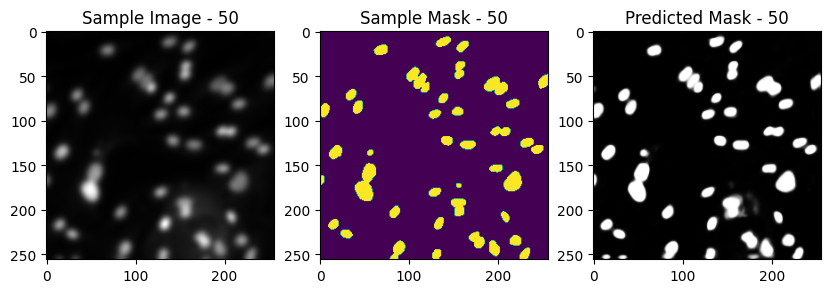

In [ ]:
# load the trained model
model = tf.keras.models.load_model('physical_1.h5',custom_objects={'dice_coef': dice_coef,'AberrationCorrection': AberrationCorrection})

# evaluate the model on the test dataset
test_scores = model.evaluate(X_test, y_test)
# loss, accuracy = model.evaluate(test_data)

# print the evaluation results
# print('Test Loss:', loss)
# print('Test Accuracy:', accuracy)
print(test_scores)

for i in range(50):
  fig, axs = plt.subplots(1, 3, figsize=(10, 5))
  axs[0].imshow(X_test[i])
  axs[0].set_title(f'Sample Image - {i+1}')
  axs[1].imshow(y_test[i])
  axs[1].set_title(f'Sample Mask - {i+1}')
  axs[2].imshow(np.squeeze(model.predict(np.expand_dims(X_test[i], axis=0))), cmap='gray')
  axs[2].set_title(f'Predicted Mask - {i+1}')
  plt.show()

# Design - 2

In [ ]:
class SphericalAberrationLayer(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()

    def build(self, input_shape):
        self.coefficients = self.add_weight(shape=(5,),  dtype=tf.float64, initializer='random_normal', trainable=True)

    @tf.function
    def call(self, inputs):
        # Compute the correction using the trainable parameters
        c1, c2, c3, c4, c5 = tf.unstack(self.coefficients)
        x, y = tf.meshgrid(tf.linspace(-1, 1, inputs.shape[1]), tf.linspace(-1, 1, inputs.shape[2]), indexing='ij')
        x = tf.cast(x, dtype=tf.float64)
        y = tf.cast(y, dtype=tf.float64)
        r_squared = x ** 2 + y ** 2
        correction = 1 + c1 * r_squared + c2 * r_squared ** 2 + c3 * r_squared ** 3 + c4 * r_squared ** 4 + c5 * r_squared ** 5

        # Apply the correction to each channel separately
        corrected_channels = []
        for i in range(inputs.shape[-1]):
            channel = inputs[:, :, :, i]
            corrected_channel = channel / tf.cast(correction, tf.float32)
            corrected_channels.append(corrected_channel)
        corrected = tf.stack(corrected_channels, axis=-1)
        
        return corrected

In [ ]:
def unet(pretrained_weights = None,input_size = (256, 256, 3)):
    inputs = Input(input_size, dtype=tf.float64)
    # inputs = tf.cast(inputs, tf.float64)
    # x = AberrationCorrection()(inputs)
    x = SphericalAberrationLayer()(inputs)
    # print(x.shape)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(x)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    drop1 = tf.keras.layers.Dropout(0.1)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(drop1)
    
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv2)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    drop2 = tf.keras.layers.Dropout(0.1)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(drop2)
    
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    drop3 = tf.keras.layers.Dropout(0.2)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(drop3)
    
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv4)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    drop4 = tf.keras.layers.Dropout(0.2)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    drop5 = tf.keras.layers.Dropout(0.3)(conv5)

    up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop5))
    merge6 = tf.keras.layers.concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    drop6 = tf.keras.layers.Dropout(0.2)(conv6)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop6))
    merge7 = tf.keras.layers.concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    drop7 = tf.keras.layers.Dropout(0.2)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop7))
    merge8 = tf.keras.layers.concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    drop8 = tf.keras.layers.Dropout(0.1)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop8))
    merge9 = tf.keras.layers.concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(2, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    drop9 = tf.keras.layers.Dropout(0.1)(conv9)
    
    conv10 = Conv2D(1, 1, activation = 'sigmoid')(drop9)

    model = Model(inputs = inputs, outputs = conv10)
    
    adam=tf.keras.optimizers.Adam( learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

    model.compile(optimizer = adam, loss = ['binary_crossentropy'], metrics = ['accuracy', dice_coef])
    
    model.summary()

    # if(pretrained_weights):
    # 	model.load_weights(pretrained_weights)

    return model
    # plot_model(model, to_file = '/content/drive/MyDrive/256imagesforUnet/Unetmodel.png')

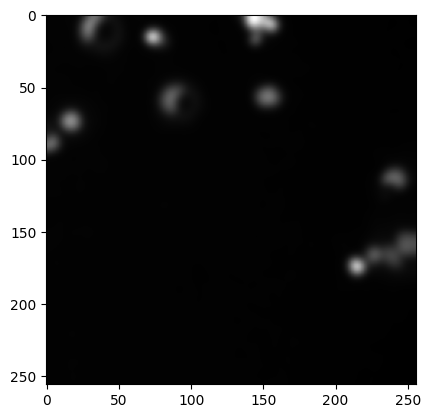

In [ ]:
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

In [ ]:
print('X_train: ', X_train.shape, '\n', 'y_train: ', y_train.shape)
X_train = tf.cast(X_train, tf.float64)

X_train:  (536, 256, 256, 3) 
 y_train:  (536, 256, 256)


In [ ]:
# # checkpointer = tf.keras.callbacks.ModelCheckpoint('unetIOU6.h5', verbose=1, save_best_only=True)
earlystopper = tf.keras.callbacks.EarlyStopping(patience = 5, monitor='val_loss')
# lr_callback = tf.keras.callbacks.LearningRateScheduler(lr_scheduler)
# # tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [ earlystopper]
##############
model = unet()
##############
results = model.fit(X_train, y_train
                    , batch_size=8
                    , epochs=50
#                     , validation_data=(x_val, y_val)
                    , validation_split=0.3
                    , shuffle=True
                    # , validation_data=(X_val, Y_val)
                    # , use_multiprocessing=True
                    , verbose = 1)

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 spherical_aberration_layer (Sp  (None, 256, 256, 3)  5          ['input_3[0][0]']                
 hericalAberrationLayer)                                                                          
                                                                                                  
 conv2d_48 (Conv2D)             (None, 256, 256, 64  1792        ['spherical_aberration_layer[0][0
                                )                                ]']                        

In [ ]:
model.save('physical_2.h5')

In [ ]:
# history_df = pd.DataFrame(results.history)

# # Save the DataFrame to a CSV file
# history_df.to_csv('/content/Dataset/no_aug_spherical_50e_physical_yes.csv', index=False)

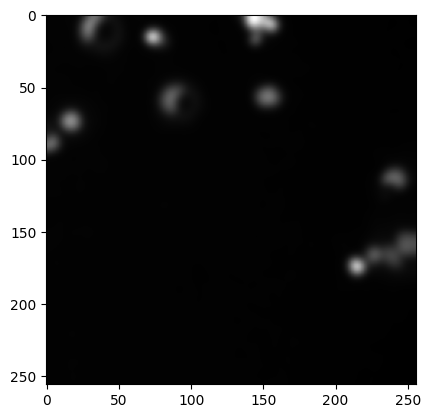

In [ ]:
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

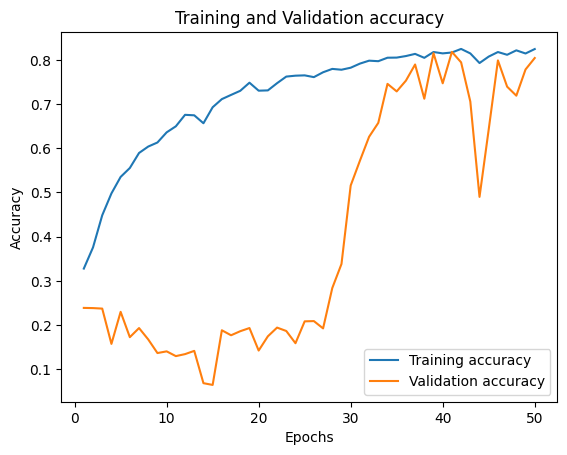

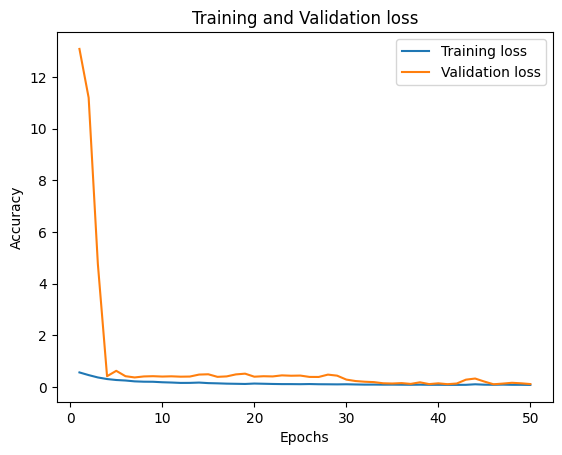

In [ ]:
train_acc = results.history['dice_coef']
val_acc = results.history['val_dice_coef']

# number of epochs
epochs = range(1, len(train_acc) + 1)

# plot the train and validation accuracy
plt.figure()
plt.plot(epochs, train_acc, label='Training accuracy')
plt.plot(epochs, val_acc, label='Validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# plot the train and validation loss
plt.figure()
plt.plot(epochs, results.history['loss'], label='Training loss')
plt.plot(epochs, results.history['val_loss'], label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

5/5 [==============================] - 1s 80ms/step - loss: 0.1055 - accuracy: 0.9543 - dice_coef: 0.7801
[0.10548074543476105, 0.9542700052261353, 0.7800956964492798]
1/1 [==============================] - 0s 461ms/step


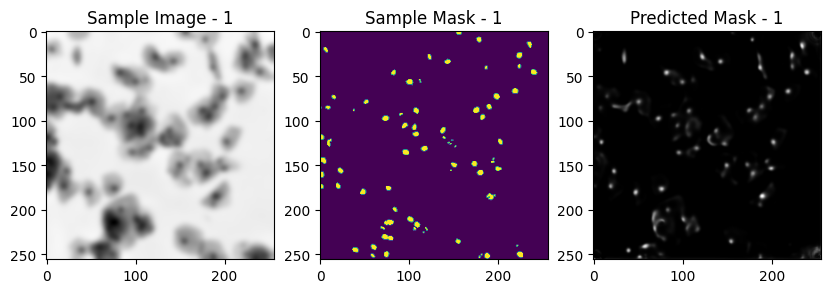

1/1 [==============================] - 0s 23ms/step


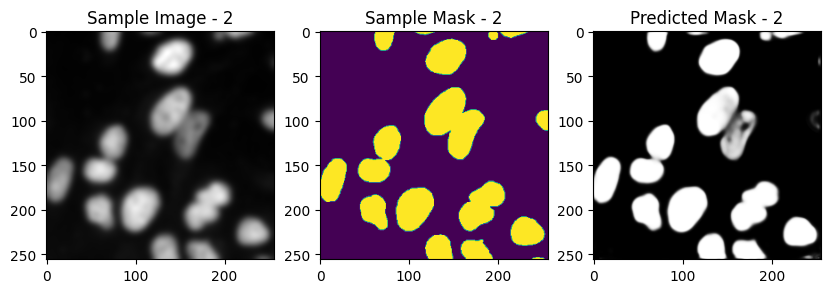

1/1 [==============================] - 0s 23ms/step


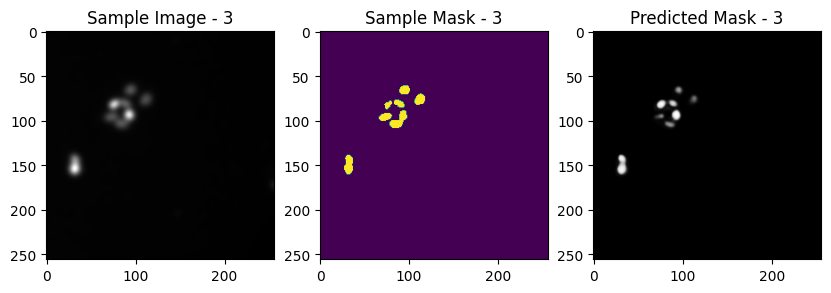

1/1 [==============================] - 0s 23ms/step


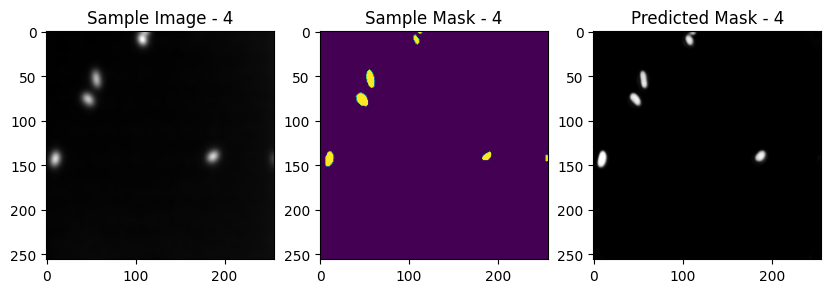

1/1 [==============================] - 0s 23ms/step


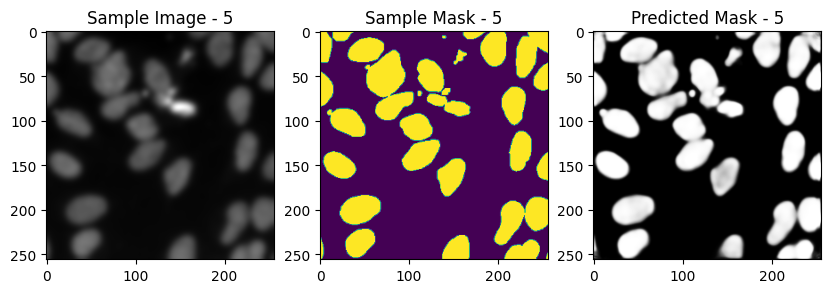

1/1 [==============================] - 0s 24ms/step


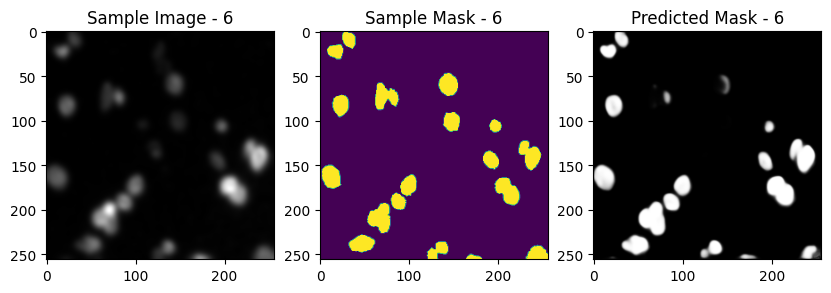

1/1 [==============================] - 0s 23ms/step


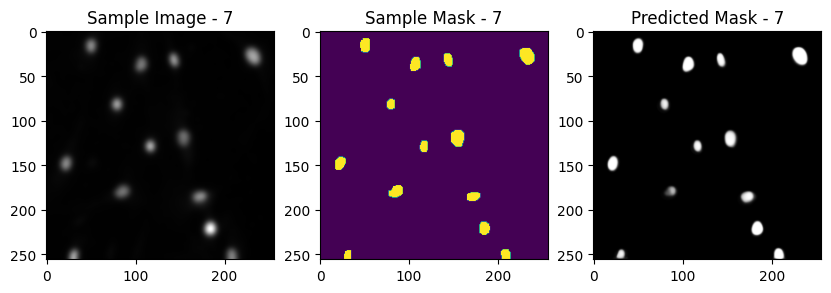

1/1 [==============================] - 0s 23ms/step


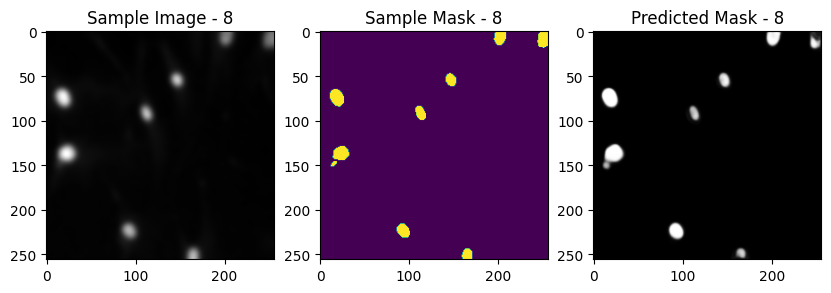

1/1 [==============================] - 0s 23ms/step


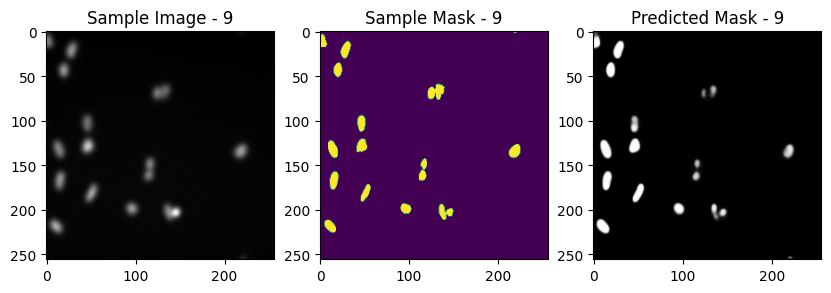

1/1 [==============================] - 0s 23ms/step


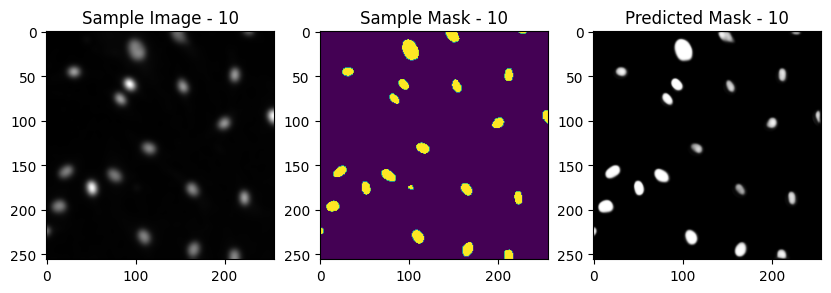

1/1 [==============================] - 0s 24ms/step


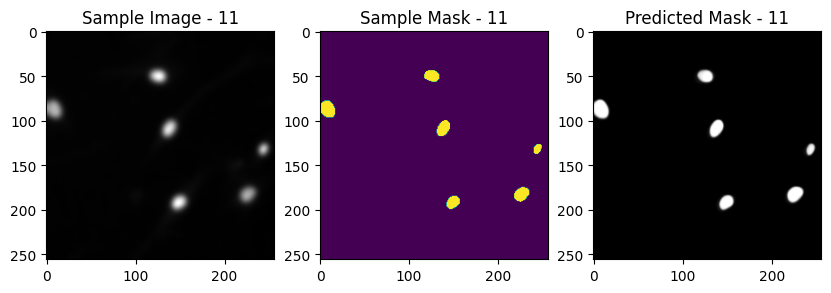

1/1 [==============================] - 0s 23ms/step


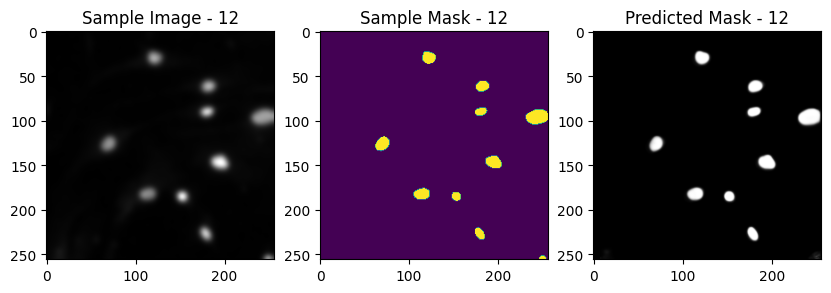

1/1 [==============================] - 0s 22ms/step


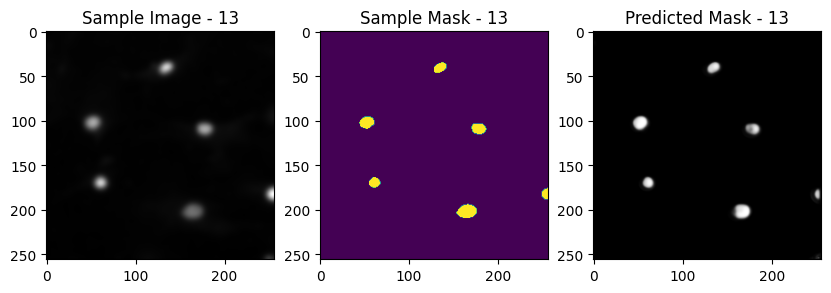

1/1 [==============================] - 0s 23ms/step


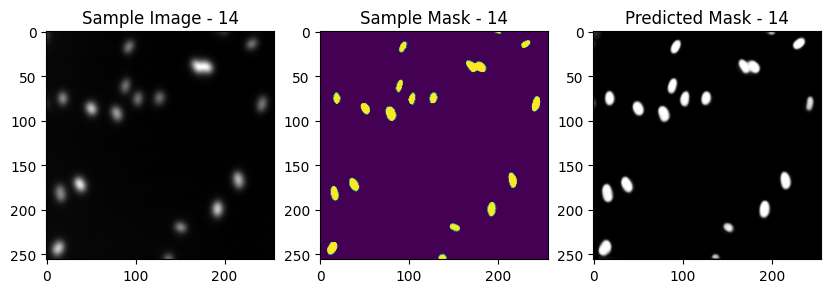

1/1 [==============================] - 0s 23ms/step


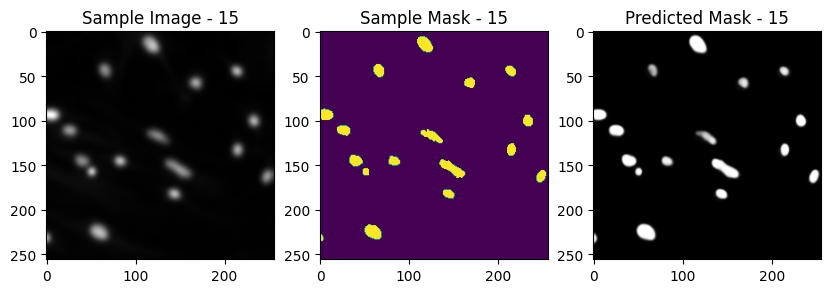

1/1 [==============================] - 0s 23ms/step


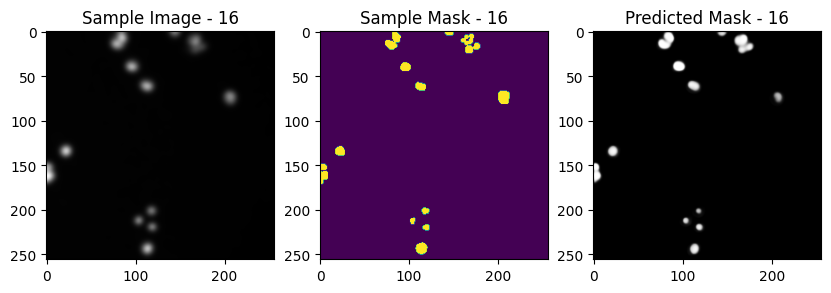

1/1 [==============================] - 0s 26ms/step


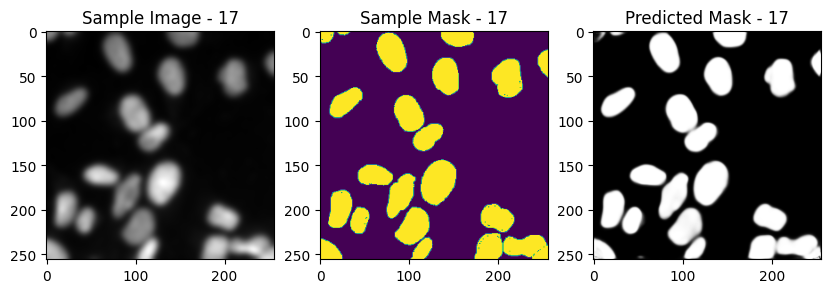

1/1 [==============================] - 0s 25ms/step


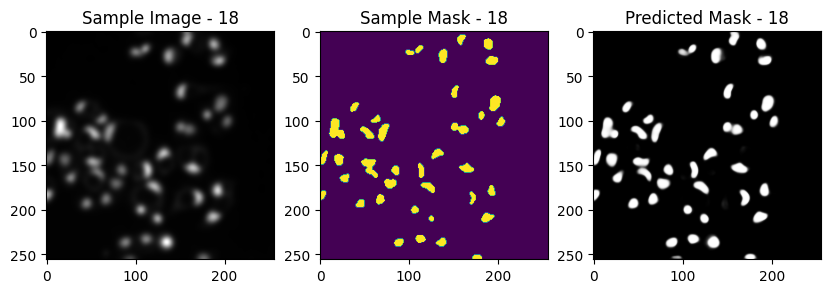

1/1 [==============================] - 0s 25ms/step


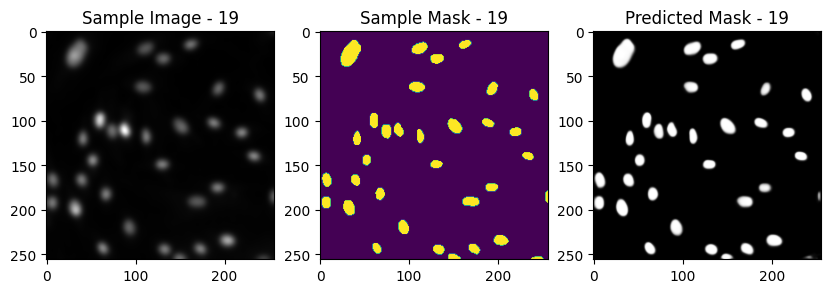

1/1 [==============================] - 0s 26ms/step


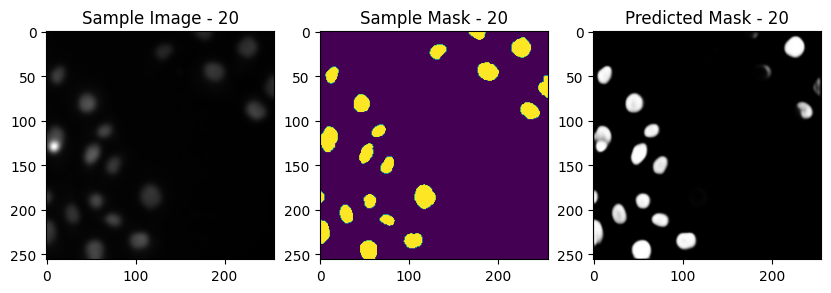

1/1 [==============================] - 0s 25ms/step


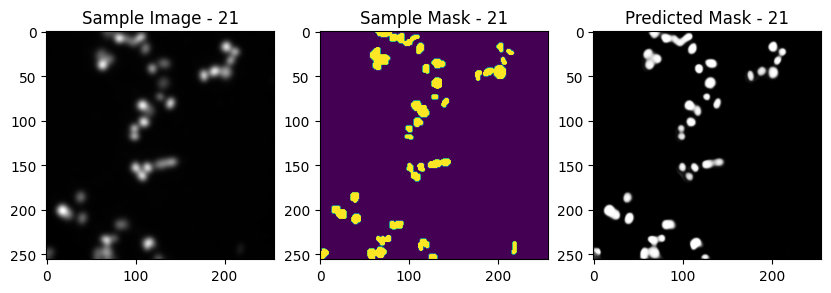

1/1 [==============================] - 0s 25ms/step


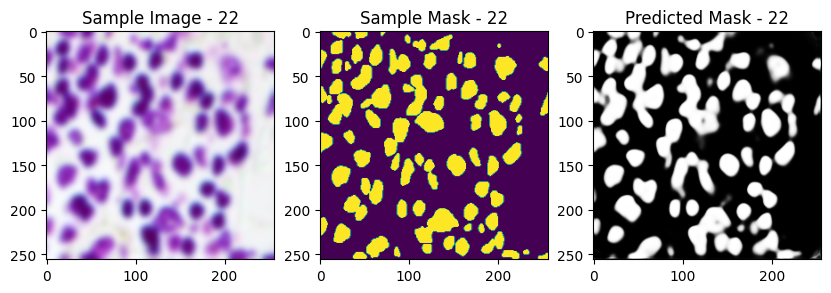

1/1 [==============================] - 0s 26ms/step


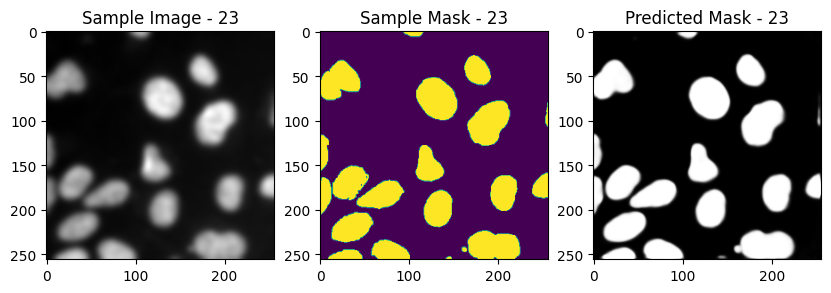

1/1 [==============================] - 0s 25ms/step


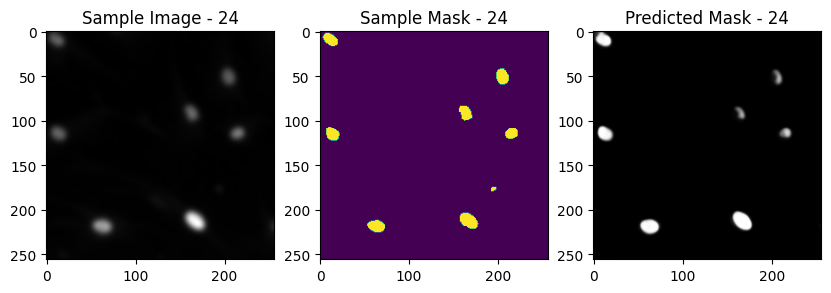

1/1 [==============================] - 0s 25ms/step


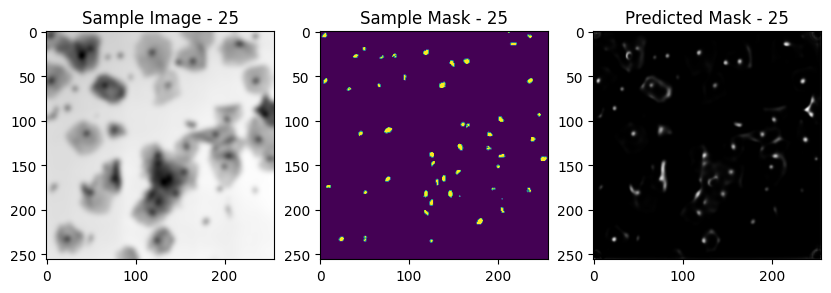

1/1 [==============================] - 0s 25ms/step


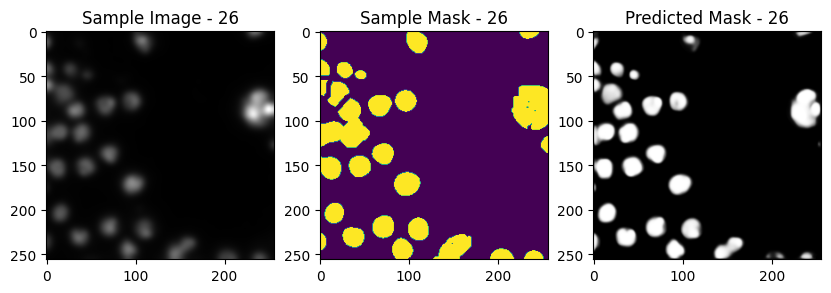

1/1 [==============================] - 0s 25ms/step


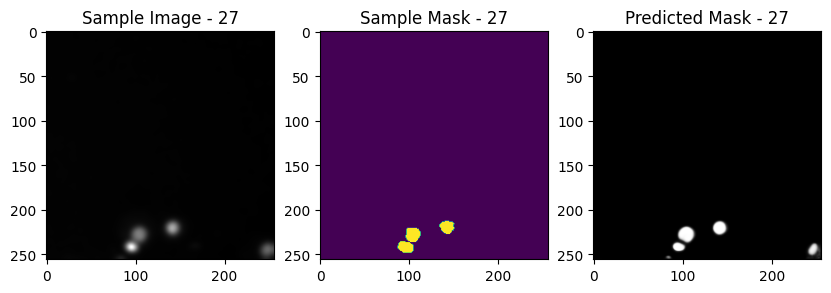

1/1 [==============================] - 0s 25ms/step


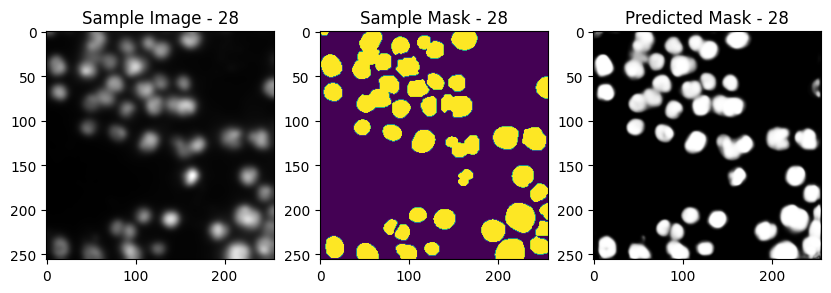

1/1 [==============================] - 0s 25ms/step


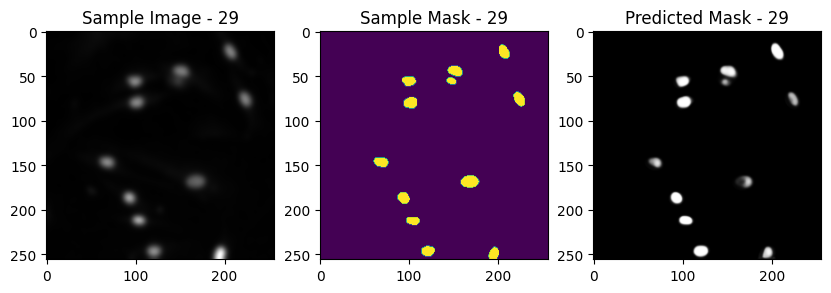

1/1 [==============================] - 0s 25ms/step


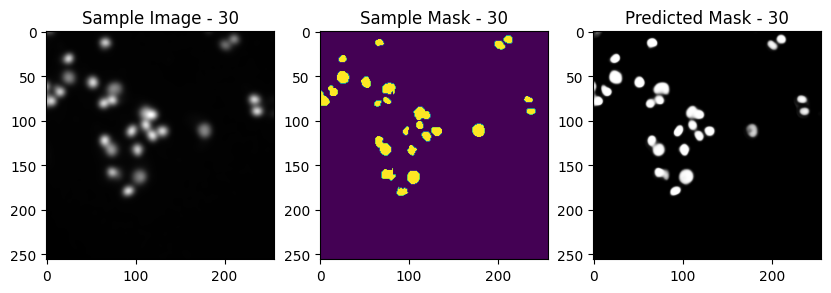

1/1 [==============================] - 0s 24ms/step


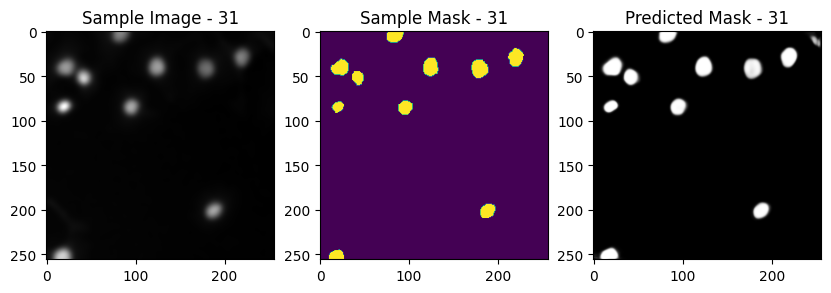

1/1 [==============================] - 0s 24ms/step


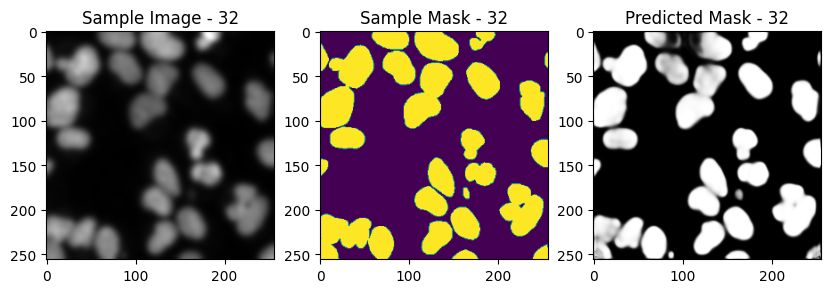

1/1 [==============================] - 0s 24ms/step


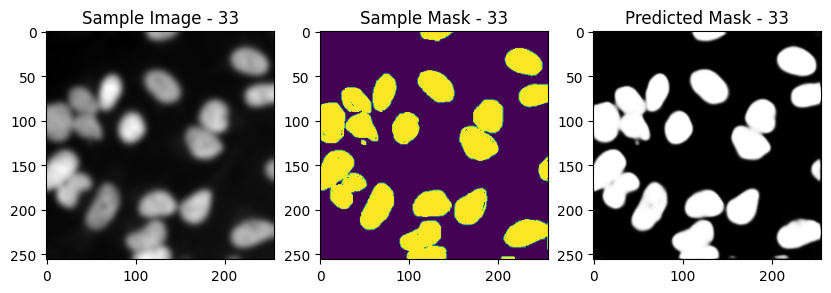

1/1 [==============================] - 0s 25ms/step


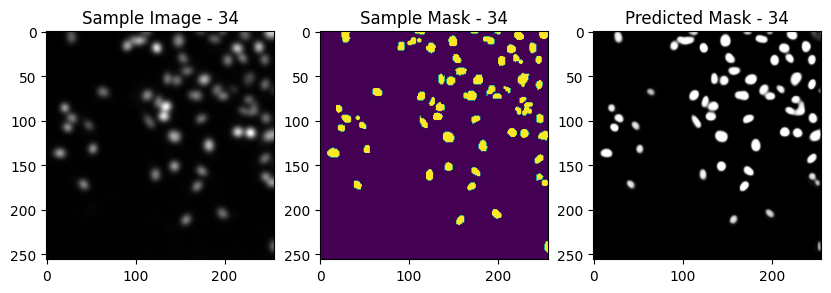

1/1 [==============================] - 0s 25ms/step


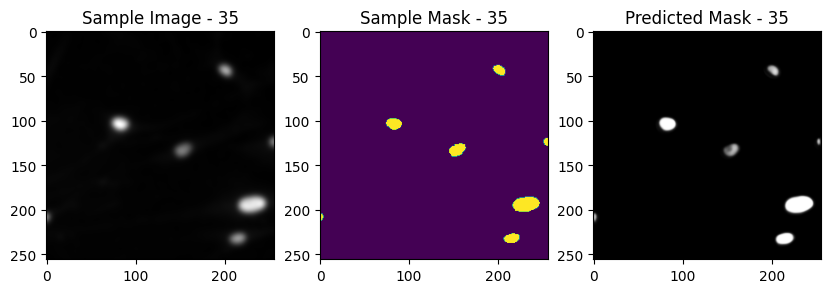

1/1 [==============================] - 0s 26ms/step


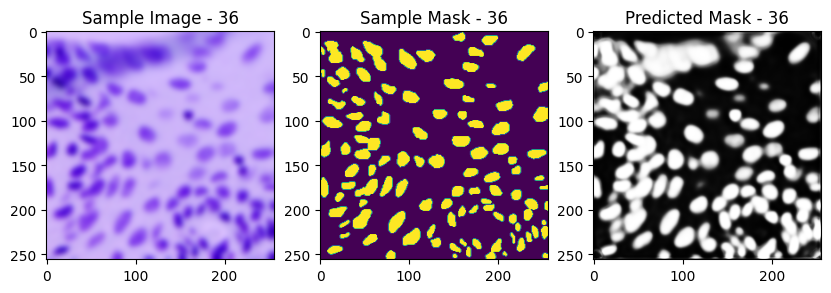

1/1 [==============================] - 0s 27ms/step


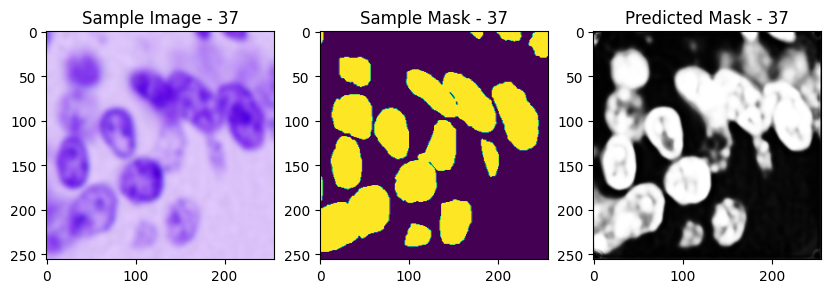

1/1 [==============================] - 0s 26ms/step


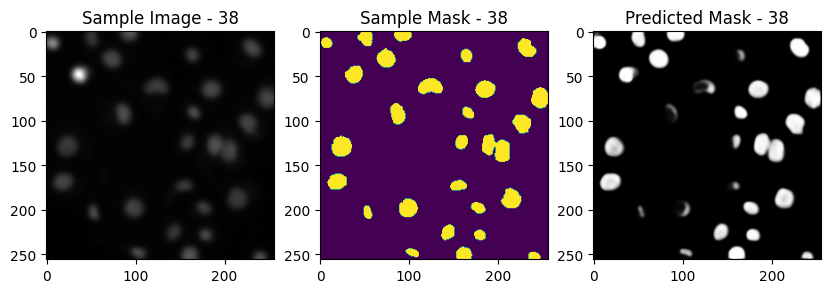

1/1 [==============================] - 0s 24ms/step


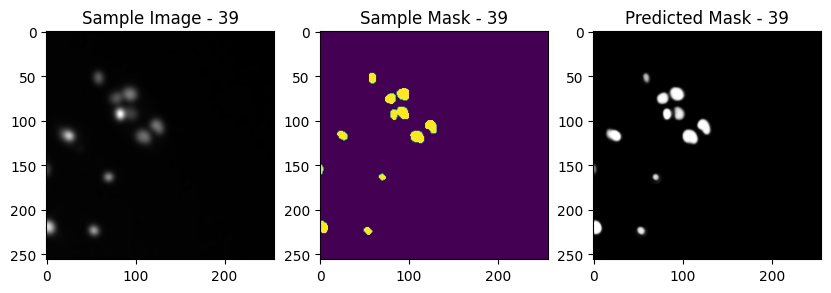

1/1 [==============================] - 0s 24ms/step


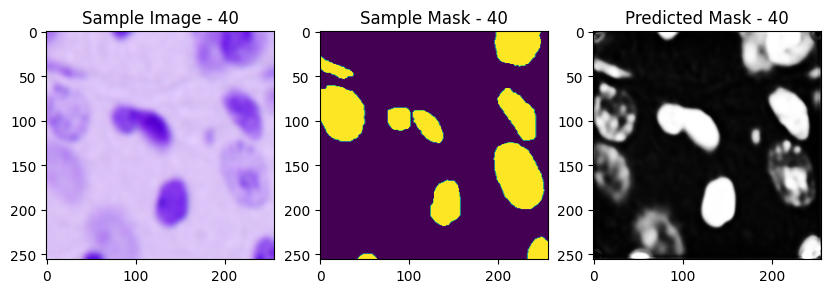

1/1 [==============================] - 0s 26ms/step


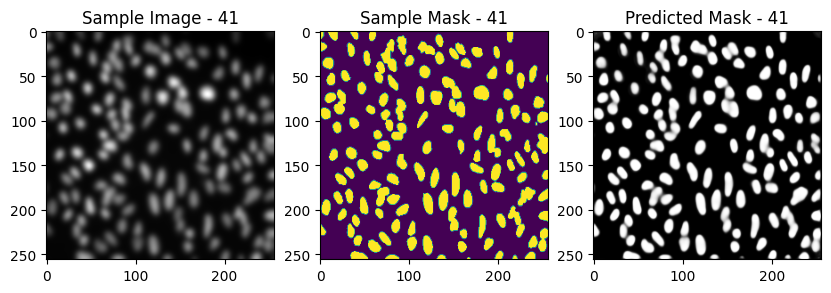

1/1 [==============================] - 0s 24ms/step


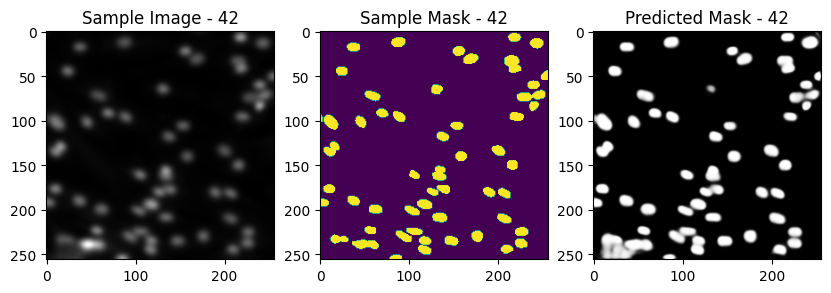

1/1 [==============================] - 0s 24ms/step


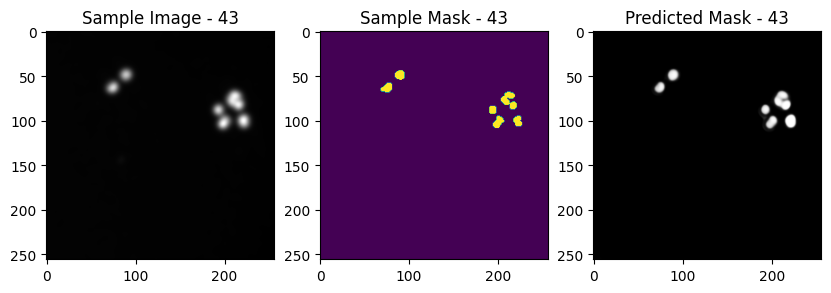

1/1 [==============================] - 0s 24ms/step


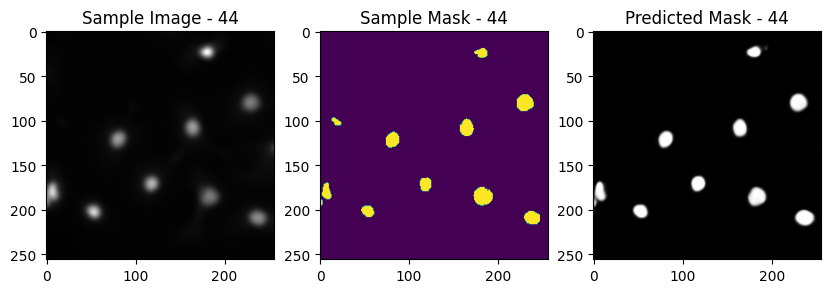

1/1 [==============================] - 0s 24ms/step


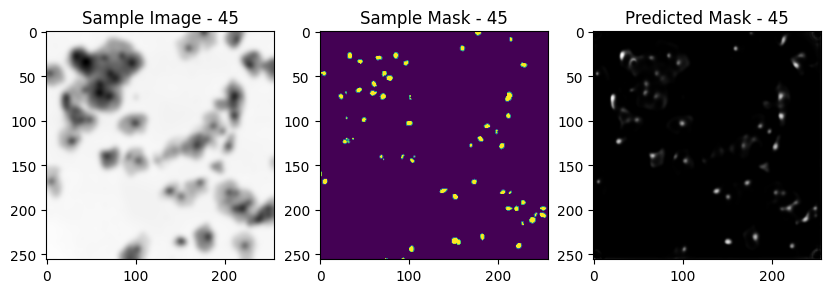

1/1 [==============================] - 0s 24ms/step


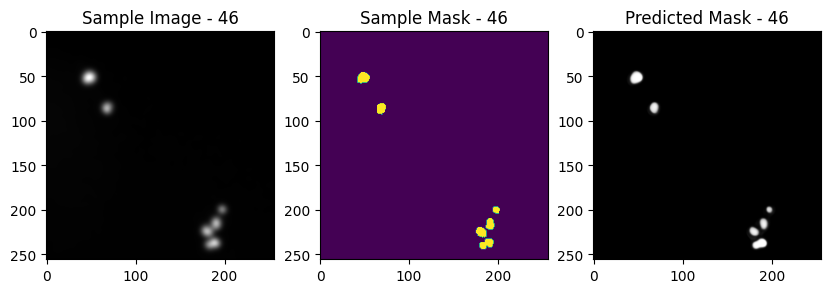

1/1 [==============================] - 0s 24ms/step


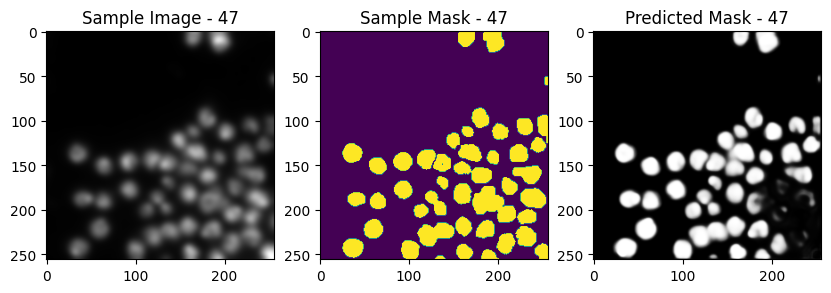

1/1 [==============================] - 0s 23ms/step


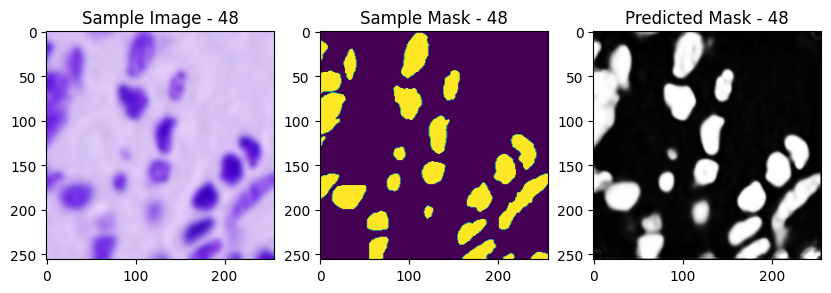

1/1 [==============================] - 0s 24ms/step


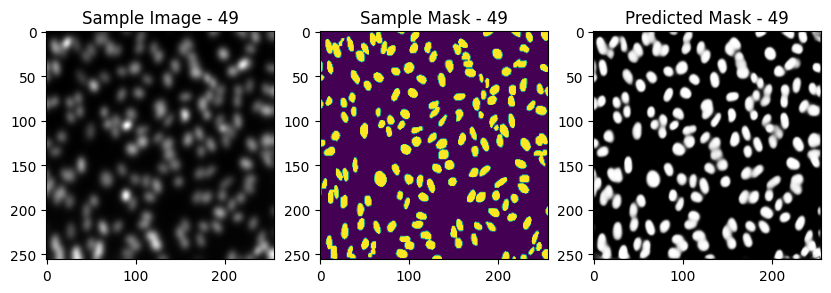

1/1 [==============================] - 0s 24ms/step


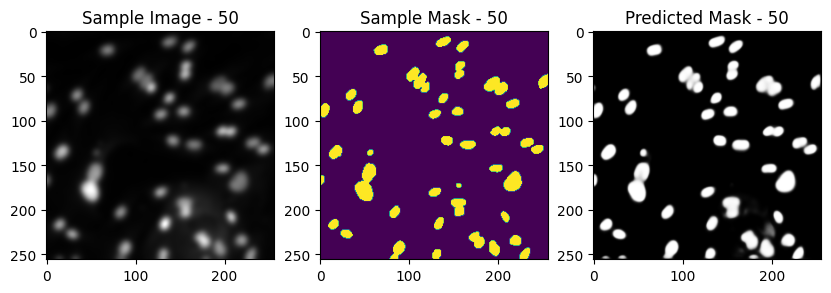

In [ ]:
# load the trained model
model = tf.keras.models.load_model('physical_2.h5',custom_objects={'dice_coef': dice_coef,'SphericalAberrationLayer': SphericalAberrationLayer})

# evaluate the model on the test dataset
test_scores = model.evaluate(X_test, y_test)
# loss, accuracy = model.evaluate(test_data)

# print the evaluation results
# print('Test Loss:', loss)
# print('Test Accuracy:', accuracy)
print(test_scores)

for i in range(50):
  fig, axs = plt.subplots(1, 3, figsize=(10, 5))
  axs[0].imshow(X_test[i])
  axs[0].set_title(f'Sample Image - {i+1}')
  axs[1].imshow(y_test[i])
  axs[1].set_title(f'Sample Mask - {i+1}')
  axs[2].imshow(np.squeeze(model.predict(np.expand_dims(X_test[i], axis=0))), cmap='gray')
  axs[2].set_title(f'Predicted Mask - {i+1}')
  plt.show()

# Design 3

In [ ]:
import tensorflow as tf
import numpy as np

class SphericalAberrationLayer(tf.keras.layers.Layer):
    def __init__(self):
        super().__init__()
        self.c = self.add_weight(shape=(1,), initializer='zeros', trainable=True)
    
    def call(self, inputs):
      input_shape = tf.shape(inputs)
      x = tf.linspace(-1.0, 1.0, input_shape[-2])
      y = tf.linspace(-1.0, 1.0, input_shape[-3])
      xx, yy = tf.meshgrid(x, y)
      r_squared = xx**2 + yy**2
      
      # Compute the Z4 Zernike polynomial
      z4 = np.sqrt(5.0) * (6.0*r_squared**2 - 6.0*r_squared + 1.0)
      
      # Add the aberration correction to the Fourier domain
      aberration = tf.cast(self.c, dtype=tf.complex64) * tf.cast(z4, dtype=tf.complex64)
      aberration = tf.expand_dims(aberration, axis=-1) # Add new axis along last dimension
      fft = tf.signal.fft2d(tf.cast(inputs, dtype=tf.complex64))
      fft_aberrated = tf.cast(tf.signal.ifft2d(fft * tf.exp(tf.complex(0.0, 1.0) * aberration)), dtype=tf.float32)

      max_val = tf.reduce_max(inputs)
      min_val = tf.reduce_min(inputs)
      output = (fft_aberrated - tf.reduce_min(fft_aberrated)) / (tf.reduce_max(fft_aberrated) - tf.reduce_min(fft_aberrated)) * (max_val - min_val) + min_val
      
      return output

In [ ]:
def unet(pretrained_weights = None,input_size = (256, 256, 3)):
    inputs = Input(input_size, dtype=tf.float64)
    # inputs = tf.cast(inputs, tf.float64)
    # x = AberrationCorrection()(inputs)
    x = SphericalAberrationLayer()(inputs)
    # print(x.shape)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(x)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv1)
    conv1 =tf.keras.layers.BatchNormalization()(conv1)
    drop1 = tf.keras.layers.Dropout(0.1)(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(drop1)
    
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool1)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv2)
    conv2 =tf.keras.layers.BatchNormalization()(conv2)
    drop2 = tf.keras.layers.Dropout(0.1)(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(drop2)
    
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool2)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv3)
    conv3 =tf.keras.layers.BatchNormalization()(conv3)
    drop3 = tf.keras.layers.Dropout(0.2)(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(drop3)
    
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool3)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv4)
    conv4 =tf.keras.layers.BatchNormalization()(conv4)
    drop4 = tf.keras.layers.Dropout(0.2)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(pool4)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    conv5 = Conv2D(1024, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv5)
    conv5 =tf.keras.layers.BatchNormalization()(conv5)
    drop5 = tf.keras.layers.Dropout(0.3)(conv5)

    up6 = Conv2D(512, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop5))
    merge6 = tf.keras.layers.concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    conv6 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv6)
    conv6 =tf.keras.layers.BatchNormalization()(conv6)
    drop6 = tf.keras.layers.Dropout(0.2)(conv6)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop6))
    merge7 = tf.keras.layers.concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv7)
    conv7 =tf.keras.layers.BatchNormalization()(conv7)
    drop7 = tf.keras.layers.Dropout(0.2)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop7))
    merge8 = tf.keras.layers.concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv8)
    conv8 =tf.keras.layers.BatchNormalization()(conv8)
    drop8 = tf.keras.layers.Dropout(0.1)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(UpSampling2D(size = (2,2))(drop8))
    merge9 = tf.keras.layers.concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(merge9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    conv9 = Conv2D(2, 3, activation = 'relu', padding = 'same', kernel_initializer = 'he_normal')(conv9)
    conv9 =tf.keras.layers.BatchNormalization()(conv9)
    drop9 = tf.keras.layers.Dropout(0.1)(conv9)
    
    conv10 = Conv2D(1, 1, activation = 'sigmoid')(drop9)

    model = Model(inputs = inputs, outputs = conv10)
    
    adam=tf.keras.optimizers.Adam( learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07)

    model.compile(optimizer = adam, loss = ['binary_crossentropy'], metrics = ['accuracy', dice_coef])
    
    model.summary()

    # if(pretrained_weights):
    # 	model.load_weights(pretrained_weights)

    return model
    # plot_model(model, to_file = '/content/drive/MyDrive/256imagesforUnet/Unetmodel.png')

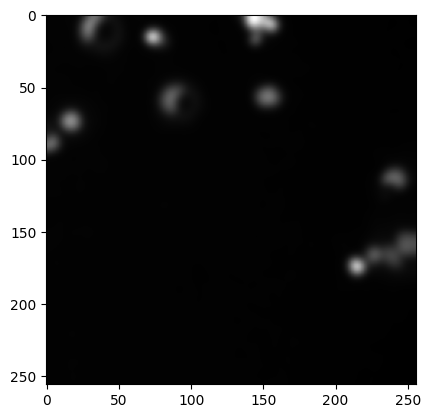

In [ ]:
# model = unet()
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

In [ ]:
print('X_train: ', X_train.shape, '\n', 'y_train: ', y_train.shape)
X_train = tf.cast(X_train, tf.float64)

X_train:  (536, 256, 256, 3) 
 y_train:  (536, 256, 256)


In [ ]:
# # checkpointer = tf.keras.callbacks.ModelCheckpoint('unetIOU6.h5', verbose=1, save_best_only=True)
earlystopper = tf.keras.callbacks.EarlyStopping(patience = 5, monitor='val_loss')
# lr_callback = tf.keras.callbacks.LearningRateScheduler(lr_scheduler)
# # tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

callbacks = [ earlystopper]
##############
model = unet()
##############
results = model.fit(X_train, y_train
                    , batch_size=8
                    , epochs=50
#                     , validation_data=(x_val, y_val)
                    , validation_split=0.3
                    , shuffle=True
                    # , validation_data=(X_val, Y_val)
                    # , use_multiprocessing=True
                    , verbose = 1)

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 spherical_aberration_layer_3 (  (None, 256, 256, 3)  1          ['input_4[0][0]']                
 SphericalAberrationLayer)                                                                        
                                                                                                  
 conv2d_72 (Conv2D)             (None, 256, 256, 64  1792        ['spherical_aberration_layer_3[0]
                                )                                [0]']                      

47/47 [==============================] - ETA: 0s - loss: 0.5831 - accuracy: 0.8689 - dice_coef: 0.3083

47/47 [==============================] - 21s 122ms/step - loss: 0.5831 - accuracy: 0.8689 - dice_coef: 0.3083 - val_loss: 12.1398 - val_accuracy: 0.1386 - val_dice_coef: 0.2391
Epoch 2/50
47/47 [==============================] - 5s 105ms/step - loss: 0.5164 - accuracy: 0.9323 - dice_coef: 0.3477 - val_loss: 8.7377 - val_accuracy: 0.2871 - val_dice_coef: 0.2586
Epoch 3/50
47/47 [==============================] - 5s 106ms/step - loss: 0.4718 - accuracy: 0.9327 - dice_coef: 0.3712 - val_loss: 10.4281 - val_accuracy: 0.1669 - val_dice_coef: 0.2357
Epoch 4/50
47/47 [==============================] - 5s 105ms/step - loss: 0.4174 - accuracy: 0.9476 - dice_coef: 0.4063 - val_loss: 1.3259 - val_accuracy: 0.3484 - val_dice_coef: 0.2492
Epoch 5/50
47/47 [==============================] - 5s 105ms/step - loss: 0.3796 - accuracy: 0.9475 - dice_coef: 0.4295 - val_loss: 0.7127 - val_accuracy: 0.4366 - val_dice_coef: 0.3093
Epoch 6/50
47/47 [==============================] - 5s 105ms/step - loss: 0.34

In [ ]:
model.save('physical_3_new_lr.h5')

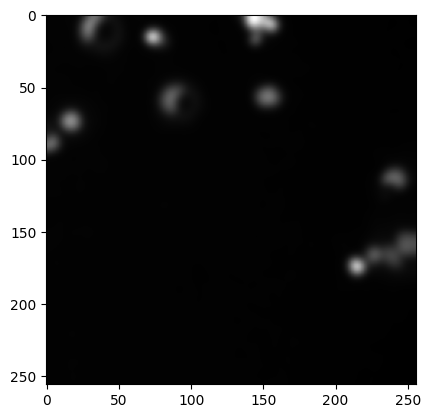

In [ ]:
ab_correction = model.layers[0]
predictions = ab_correction(X_train).numpy()
plt.imshow(predictions[0, :, :, :])
plt.show()

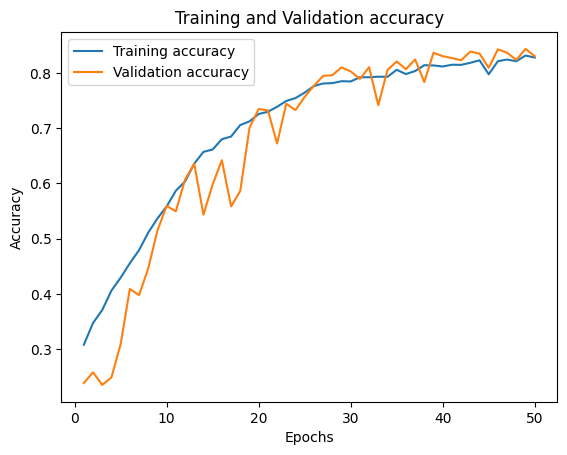

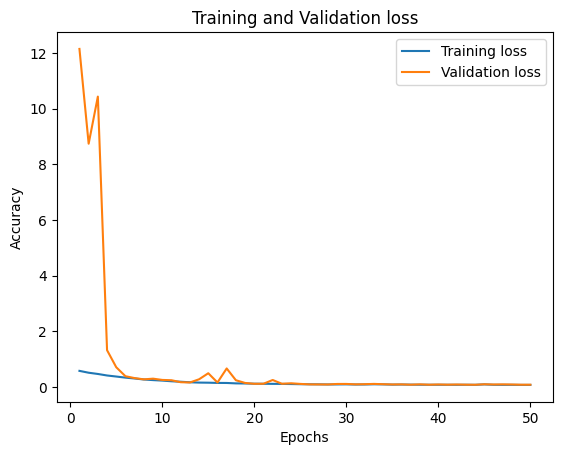

In [ ]:
train_acc = results.history['dice_coef']
val_acc = results.history['val_dice_coef']

# number of epochs
epochs = range(1, len(train_acc) + 1)

# plot the train and validation accuracy
plt.figure()
plt.plot(epochs, train_acc, label='Training accuracy')
plt.plot(epochs, val_acc, label='Validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

# plot the train and validation loss
plt.figure()
plt.plot(epochs, results.history['loss'], label='Training loss')
plt.plot(epochs, results.history['val_loss'], label='Validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
np.shape(X_test[i])

(256, 256, 3)

In [ ]:
preds = model.predict(X_test)


5/5 [==============================] - 1s 95ms/step


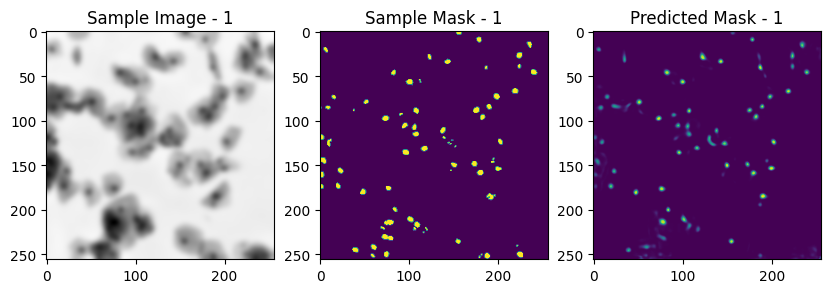

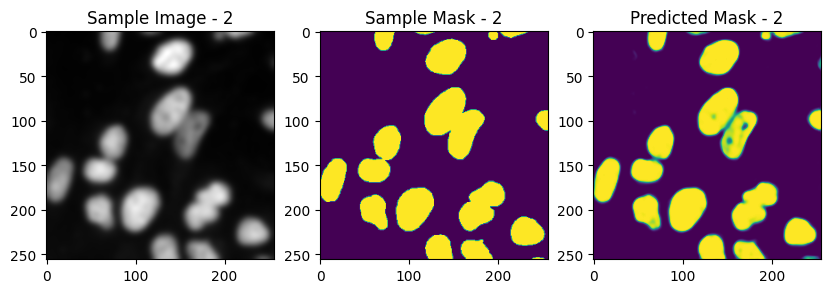

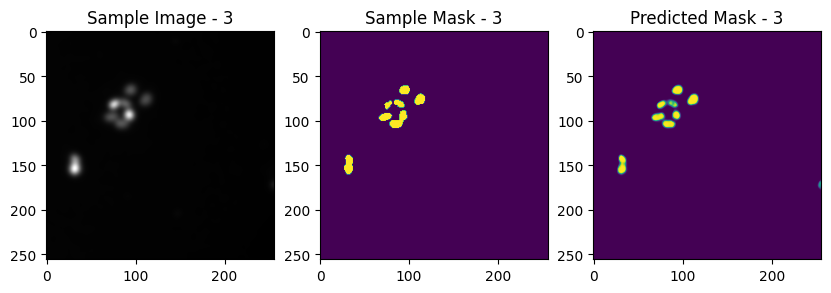

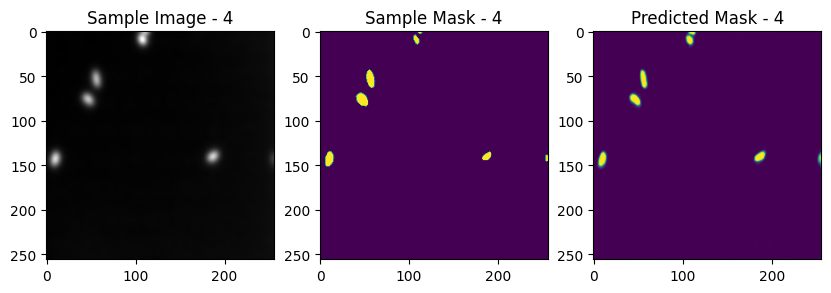

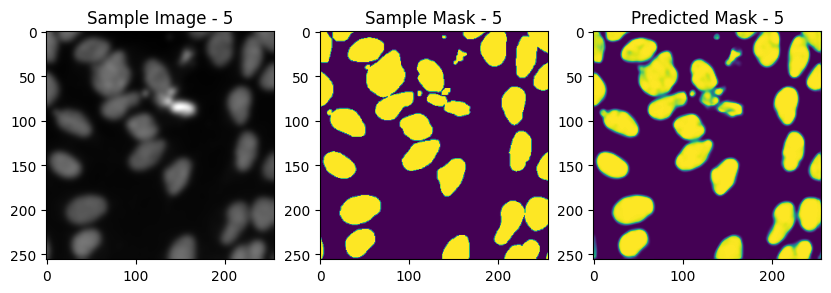

...

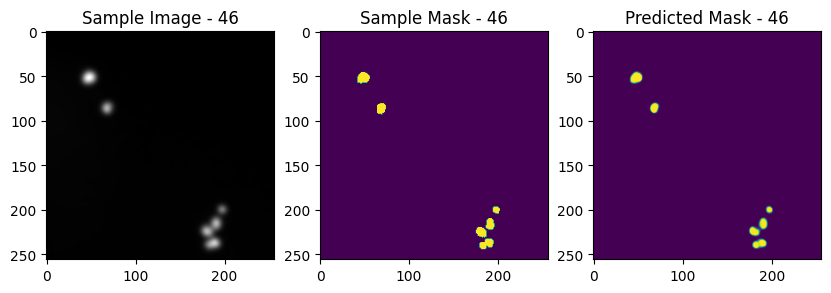

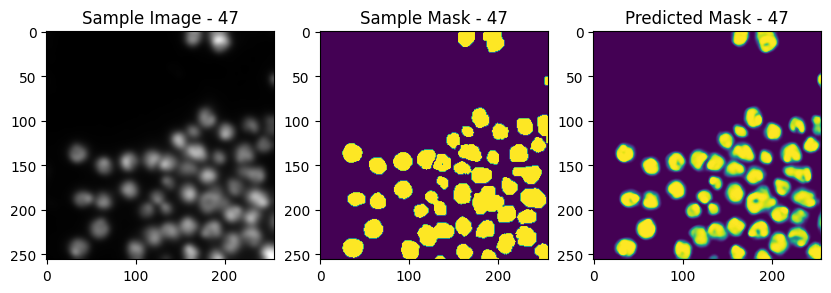

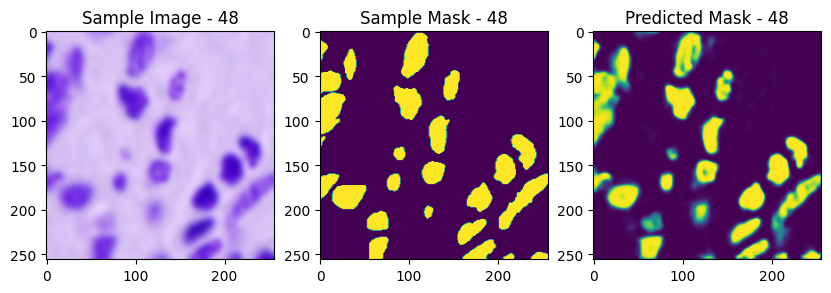

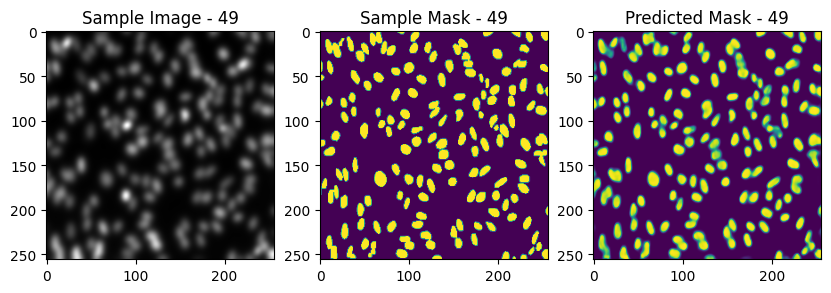

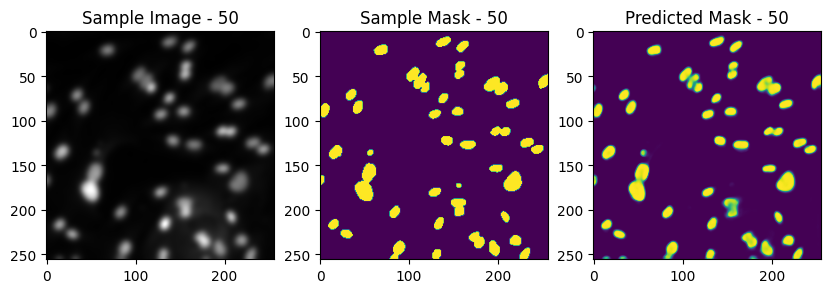

In [ ]:
for i in range(50):
  fig, axs = plt.subplots(1, 3, figsize=(10, 5))
  axs[0].imshow(X_test[i])
  axs[0].set_title(f'Sample Image - {i+1}')
  axs[1].imshow(y_test[i])
  axs[1].set_title(f'Sample Mask - {i+1}')
  axs[2].imshow(preds[i])
  axs[2].set_title(f'Predicted Mask - {i+1}')
  plt.show()

In [ ]:
# load the trained model
# model = tf.keras.models.load_model('physical_3.h5')

# evaluate the model on the test dataset
test_scores = model.evaluate(X_test, y_test)
print(test_scores)


5/5 [==============================] - 1s 83ms/step - loss: 0.0770 - accuracy: 0.9644 - dice_coef: 0.8137
[0.07700833678245544, 0.9643728733062744, 0.8136680722236633]
